# Nb for making some plots for the  paper

Concerns mostly the image fusion images.

In [1]:
import json
import sys
sys.path.append('../../..')

from collections import Counter
import os
from os.path import join, exists

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.set_option("mode.chained_assignment", None)
import scipy
import seaborn as sns
from tqdm import tqdm
import SimpleITK as sitk
from PIL import Image

from miit.reg_graph import RegGraph
from miit.utils.image_utils import apply_mask
from miit.spatial_data.section import Section

In [2]:
def merge_dicts(dict1, dict2):
    new_dict = {}
    for key in dict1:
        if dict1[key] in dict2:
            new_dict[key] = dict2[dict1[key]]
    return new_dict

def get_st_identifier(core_name, metadata_df):
    st_identifier = metadata_df[metadata_df.core_name == core_name]['correct_st_identifier'].values[0]
    return st_identifier
    # repl_dict = {
    #     '1': 'A',
    #     '2': 'B',
    #     '3': 'C',
    #     '4': 'D'
    # }
    # return st_identifier[:-1] + repl_dict[st_identifier[-1]]

def translate_to_correct_st_identifier(identifier):
    repl_dict = {
        '1': 'A',
        '2': 'B',
        '3': 'C',
        '4': 'D'
    }
    return identifier[:-1] + repl_dict[identifier[-1]]
    
    

def build_and_store_citrate_table(core_name):
    gsea_path = 'gsea_data_SpTr_Morten_jun2023.txt'
    gsea_df = pd.read_csv(gsea_path, sep='\t', index_col=0)
    metadata_df = pd.read_csv('metadata_big.csv', index_col=0)
    # spot_annotations_df = pd.read_csv('spotAnnotations.txt', sep='\t', header=None, index_col=0)
    # spot_annotations_df.rename(columns={0: 'spot_id', 1: 'annotation'}, inplace=True)
    fpath = '/mnt/work/Maria/st_data_des21/raw_umis_reduced_raw_16122021.feather'
    spot_annotations_df = pd.read_feather(fpath)
    spot_annotations_df.set_index('index', inplace=True)
    spot_annotations_df = pd.DataFrame(spot_annotations_df['histnew'])
    
    config_path = f'../configs/cores_hr/{core_name}.json'
    st_identifier = get_st_identifier(core_name, metadata_df)
    
    integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_3/'
    st_section_path = join(integration_root_dir, core_name, '2')
    msi_section_integrated_path = join(integration_root_dir, core_name, '7')
    
    if not exists(join(msi_section_integrated_path, 'annotations_0.csv')):
        return None
    
    msi_df = pd.read_csv(join(msi_section_integrated_path, 'molecular.csv'), index_col=0)
    msi_df = msi_df.rename(columns={x: st_identifier + '_' + x for x in msi_df.columns}).transpose()
    msi_annotations_df = pd.read_csv(join(msi_section_integrated_path, 'annotations_0.csv'), index_col=0)
    msi_annotations_df.rename(index={x: st_identifier + '_' + x for x in msi_annotations_df.index}, inplace=True)
    msi_annotations_df.rename(columns={'0': 'normal_gland_msi'}, inplace=True)
    
    spot_idxs = [x for x in spot_annotations_df.index if x.startswith(st_identifier)]
    st_spot_annotations = spot_annotations_df.loc[spot_idxs]
    citsper_scores = gsea_df['Citsper'].loc[spot_idxs]
    citsper_scores_df = pd.DataFrame(citsper_scores)
    df = pd.concat([msi_df, msi_annotations_df, st_spot_annotations], axis=1)
    df['local_index'] = df.apply(lambda x: x.name.split('_', maxsplit=3)[-1], axis=1)
    df['core_name'] = core_name
    # save_path = f'citrate_tables/{core_name}.csv'
    # df.to_csv(save_path)
    return df

def get_positive_ref_mat(ref_mat, idxs):
    ret_mat = np.zeros(ref_mat.shape, dtype=int).astype(float)
    for i in range(ret_mat.shape[0]):
        for j in range(ret_mat.shape[1]):
            val = ref_mat[i,j]
            if val in idxs:
                ret_mat[i,j] = 1
    return ret_mat

def plot_spots(spot_ids, st_data, hist_img=None, ax=None):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    if hist_img is None:
        hist_img = st_data.image.data
    # spot_ids_ = get_matching_indices(spot_ids, st_data.table.data.index.to_list())
    intern_idxs = set(st_data.table.data.loc[spot_ids]['int_idx'].to_list())
    ref_mat = st_data.index_mask.data
    match_mat = get_positive_ref_mat(ref_mat, intern_idxs)
    ax.imshow(hist_img)    
    ax.imshow(match_mat, alpha=match_mat)    
    return ax

def get_matching_indices(idxs1, idxs2):
    return [x for x in idxs1 if x in idxs2]

def min_max_normalize(pd_series):
    min_ = pd_series.min()
    max_ = pd_series.max()
    return (pd_series - min_)/(max_ - min_)


def load_and_plot_gland_spots(core_name, gl_df, save_plot=True):
    if save_plot:
        plt.close()
    config_path = f'../configs/cores_hr/{core_name}.json'
    st_identifier = get_st_identifier(core_name, metadata_df)
    integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
    st_section_path = join(integration_root_dir, core_name, '2')
    st_section = Section.from_directory(st_section_path)
    st_data = st_section.molecular_data
    msi_section_integrated_path = join(integration_root_dir, core_name, '7')
    msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
    gl_small_df = gl_df[gl_df.core_name == core_name]
    gl_small_mv_df = gl_small_df[gl_small_df.normal_gland_msi > .5]
    gl_small_mv_df.loc[:, 'Citsper_norm'] = min_max_normalize(gl_small_mv_df.Citsper)
    gl_small_mv_df.loc[:, 'Citrate_norm'] = min_max_normalize(gl_small_mv_df.Citrate)
    fig, axs = plt.subplots(1, 5, figsize=(30, 6))
    # return gl_small_mv_df, st_data
    for ax in axs:
        ax.axis('off')
    axs[0].set_title('ST annotations')
    plot_spots(gl_small_df.local_index, st_data, ax=axs[0])
    axs[1].set_title('MALDI-MSI annotations')
    plot_spots(gl_small_df[gl_small_df.normal_gland_msi > 0.5].local_index, st_data, ax=axs[1])
    axs[2].set_title('MSI Histology')
    hist_img = msi_section.image.data
    plot_spots(gl_small_df[gl_small_df.normal_gland_msi > 0.5].local_index, st_data, hist_img=hist_img, ax=axs[2])
    axs[3].set_title('Citsper score')
    hist_img = st_data.image.data
    # plot_spots_with_measurement(gl_small_df[gl_small_df.normal_gland_msi > 0.5].local_index, st_data, hist_img=hist_img, ax=axs[3])
    plot_spots_with_measurement(gl_small_mv_df, st_data, 'Citrate', hist_img=hist_img, ax=axs[3])
    axs[4].set_title('Citrate score')
    hist_img = msi_section.image.data
    plot_spots_with_measurement(gl_small_mv_df, st_data, 'Citsper', hist_img=hist_img, ax=axs[4])
    # plot_spots_with_measurement(gl_small_df[gl_small_df.normal_gland_msi > 0.5].local_index, st_data, hist_img=hist_img, ax=axs[4])
    if save_plot:
        path = f'integrated_citrate_analysis/images/{core_name}.png'
        plt.savefig(path)
    
def get_measurement_dict(df, col1, col2):
    dct = {}
    for _, row in df.iterrows():
        dct[row[col1]] = row[col2]
    return dct

def get_measurement_mat(ref_mat, idxs_meas_dict):
    m_mat = np.zeros(ref_mat.shape, dtype=int).astype(float)
    for i in range(m_mat.shape[0]):
        for j in range(m_mat.shape[1]):
            val = ref_mat[i,j]
            if val in idxs_meas_dict:
                m_mat[i,j] = idxs_meas_dict[val]
    return m_mat

def plot_spots_with_measurement(measurement_df, st_data, col, hist_img=None, ax=None, quantile_norm=True):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    if hist_img is None:
        hist_img = st_data.image.data
    # spot_ids_ = get_matching_indices(spot_ids, st_data.table.data.index.to_list())
    # spot_ids = measurement_df.local_index.to_list()
    # intern_idxs = set(st_data.table.data.loc[spot_ids]['int_idx'].to_list())
    ref_mat = st_data.index_mask.data
    local_idx_measurement_dict = get_measurement_dict(measurement_df, 'local_index', col)
    st_table = st_data.table.data.loc[measurement_df.local_index.to_list()]
    intern_idx_local_idx_dict = {}
    for idx, row in st_table.iterrows():
        intern_idx_local_idx_dict[int(row['int_idx'])] = idx
    merged_dict = merge_dicts(intern_idx_local_idx_dict, local_idx_measurement_dict)
    indexer = np.array([merged_dict.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    # match_mat = get_measurement_mat(ref_mat, measurement_dict)
    ax.imshow(hist_img)    
    alpha_mat = measurement_mat.copy()
    alpha_mat[alpha_mat != 0] = 1
    if quantile_norm:
        vmin = np.quantile(measurement_mat[measurement_mat > 0], .1)
        vmax = np.quantile(measurement_mat[measurement_mat > 0], .9)
        ax.imshow(measurement_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
    else:
        ax.imshow(measurement_mat, alpha=alpha_mat)    
    return ax

def plot_stroma_gland_distribution(core_name):
    config_path = f'../configs/cores_hr/{core_name}.json'
    st_identifier = get_st_identifier(core_name, metadata_df)
    # integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
    integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
    st_section_path = join(integration_root_dir, core_name, '2')
    st_section = Section.from_directory(st_section_path)
    st_data = st_section.molecular_data
    msi_section_integrated_path = join(integration_root_dir, core_name, '7')
    msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
    # Filter tables 
    gl_small_df = cst_df[cst_df.core_name == core_name]
    gl_small_mv_df = gl_small_df[gl_small_df.normal_gland_msi > .5]
    # gl_small_mv_df.loc[:, 'Citsper_norm'] = min_max_normalize(gl_small_mv_df.Citsper)
    # gl_small_mv_df.loc[:, 'Citrate_norm'] = min_max_normalize(gl_small_mv_df.Citrate)
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    # return gl_small_mv_df, st_data
    for ax in axs:
        ax.axis('off')
    axs[0].set_title('Non-cancer gland or stroma')
    axs[1].set_title('Non-cancer gland or stroma in msi section')
    hist_img = st_data.image.data
    plot_spots_with_measurement(gl_small_df, st_data, 'tissue_num_st', hist_img=hist_img, ax=axs[0])
    plot_spots_with_measurement(gl_small_df, st_data, 'tissue_num_msi', hist_img=msi_section.image.data, ax=axs[1])

from scipy.integrate import trapezoid
from pyimzml.ImzMLParser import ImzMLParser


def get_metabolite_intensities(msi, mz_intervals, spectra_idxs):
    norm_f = tic_trapz
    intensity_f = np.max
    gen_spec = False
    baseline_f = simple_baseline
    smooth_f = None
    
    intensities_per_spot = {}
    for spectrum_idx in spectra_idxs:
        if spectrum_idx not in intensities_per_spot:
            intensities_per_spot[spectrum_idx] = []
        collected_intensities = {}
        mzs, intensities = msi.getspectrum(spectrum_idx)
        # Smoothing is still missing
        intensities = baseline_f(intensities)
        norm_factor = trapezoid(y=intensities, x=None)
        for start, end, _ in mz_intervals:
            lower_bound = find_nearest(mzs, start)
            upper_bound = find_nearest(mzs, end)        
            # intensity = norm_f(intensity_f(intensities[lower_bound[1]:upper_bound[1]]), intensities)        
            intensity = np.max(intensities[lower_bound[1]:upper_bound[1]])/norm_factor
            intensities_per_spot[spectrum_idx].append(intensity)
    return intensities_per_spot

def simple_baseline(intensities):
    # return intensities - np.median(intensities[-100:])
    return intensities - np.median(np.hstack((intensities[:100], intensities[-100:])))
    # return intensities - np.median(intensities[:100])

def tic_trapz(intensity, intensities, mz=None):
    return np.array(intensity) / trapezoid(y=intensities, x=mz)
    
def extract_ion_image(msi_section):
    msi = ImzMLParser(msi_section.molecular_data.imzml_path)
    spectra_idxs = list(range(len(msi.coordinates)))
    # mz_intervals = [(189.9423, 190.137, 'Citrate')]
    mz_intervals = [(190.5, 191.5, 'Citrate')]
    intensities = get_metabolite_intensities(msi, mz_intervals, spectra_idxs)
    return intensities

def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx], idx

def to_single_intensity_dict(dct, intensity_idx):
    return {key: dct[key][intensity_idx] for key in dct}

def map_intensities_on_image(msi_section, intensity_dict, apply_tissue_mask=True):
    ref_mat = msi_section.molecular_data.index_mask.data.copy()
    tissue_mask = msi_section.segmentation_mask.data
    indexer = np.array([intensity_dict.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    measurement_mat = measurement_mat * tissue_mask
    return measurement_mat

def get_sp_stats(df, col1, col2):
    sp_corr = scipy.stats.spearmanr(df[col1], df[col2])
    result = {
        'statistic': sp_corr.statistic,
        'pvalue': sp_corr.pvalue,
        'n': df.shape[0]
    }
    return pd.DataFrame(result, index=[0])

## Build all datasets needed for analysis

### Load gene signature data, st spots, and metadata

In [3]:
# spot_annotations_df_merged = pd.read_csv('st_msi_meta_big_correct_data.csv')
# w_spot_annotations_df_merged = pd.read_csv('st_msi_meta_big_wrong_data.csv')
spot_annotations_df_merged = pd.read_csv('/mnt/scratch/maximilw/data/global_integration_files/merged_st_msi_neg.csv')
w_spot_annotations_df_merged = pd.read_csv('/mnt/scratch/maximilw/data/global_integration_files/artificial_merged_st_msi_neg.csv')

## First step of analysis


In [4]:
spot_annotations_df_merged[spot_annotations_df_merged.adjusted_core_type == 'n'].core_name.unique()

array(['047_04', '045_03', '048_02', '002_01', '001_04', '003_02',
       '004_03'], dtype=object)

In [5]:
w_spot_annotations_df_merged = w_spot_annotations_df_merged.rename(columns={x: x.replace('met_median_', 'met_') for x in w_spot_annotations_df_merged.columns if x.startswith('met_median_')})

In [6]:
hist_classes = ['Stroma', 'Non-cancer glands']

# hist_classes = ['Stroma', 'Non-cancer glands', 'Lymphocyte-enriched stroma']
spot_annotations_df_merged_matching_f = spot_annotations_df_merged[spot_annotations_df_merged.msi_hist.isin(hist_classes)]
spot_annotations_df_merged_matching_f = spot_annotations_df_merged_matching_f[spot_annotations_df_merged_matching_f.unified_hp_class.isin(hist_classes)]
spot_annotations_df_merged_matching_f = spot_annotations_df_merged_matching_f[spot_annotations_df_merged_matching_f.adjusted_core_type == 'n']
spot_annotations_df_merged_matching_f.shape

(3606, 2509)

In [7]:
# Wrong data
w_spot_annotations_df_merged_matching_f = w_spot_annotations_df_merged[w_spot_annotations_df_merged.msi_hist.isin(hist_classes)]
w_spot_annotations_df_merged_matching_f = w_spot_annotations_df_merged_matching_f[w_spot_annotations_df_merged_matching_f.unified_hp_class.isin(hist_classes)]
w_spot_annotations_df_merged_matching_f = w_spot_annotations_df_merged_matching_f[w_spot_annotations_df_merged_matching_f.adjusted_core_type == 'n']
w_spot_annotations_df_merged_matching_f.shape

(3356, 2509)

In [8]:
w_spot_annotations_df_merged_matching_f.head(5)

,Unnamed: 0,met_Taurine,met_Aspartate,met_PEA,met_Glutamine,met_Glutamate,met_Urate,met_NAA,met_Zinc,met_Ascorbate,...,MT-ND4L - ENSG00000212907,MT-ND4 - ENSG00000198886,MT-ND5 - ENSG00000198786,MT-CYB - ENSG00000198727,AC011043.1 - ENSG00000276256,core_name,st_identifier,recurrence,Citsper,msi_hist
1818,V10A20_007_D_AAACGAGACGGTTGAT-1,51.737019,7.966292,11.237073,6.782927,33.229150,3.965826,3.350332,0.702035,3.266245,...,5.0,108.0,5.0,47.0,0.0,047_04,V10A20_007_D,recurrence,38.164507,Stroma
1819,V10A20_007_D_AAACTGCTGGCTCCAA-1,11.265431,11.287566,2.481704,2.003814,11.294929,1.202767,1.548837,3.593986,3.720868,...,5.0,37.0,4.0,34.0,7.0,047_04,V10A20_007_D,recurrence,339.997791,Non-cancer glands
1820,V10A20_007_D_AAAGGGATGTAGCAAG-1,17.444332,9.547937,2.858193,2.389881,12.053969,1.046142,1.322344,2.327442,3.795405,...,4.0,227.0,8.0,122.0,0.0,047_04,V10A20_007_D,recurrence,160.396633,Non-cancer glands
1821,V10A20_007_D_AAATACCTATAAGCAT-1,20.617979,13.976155,4.589603,3.969818,18.260584,1.858227,2.054685,0.963303,4.448666,...,2.0,67.0,4.0,61.0,0.0,047_04,V10A20_007_D,recurrence,50.438994,Stroma
1822,V10A20_007_D_AAATCGTGTACCACAA-1,52.649252,7.001928,13.379625,6.421956,31.974303,3.419197,3.457676,1.138504,3.365066,...,8.0,38.0,0.0,34.0,0.0,047_04,V10A20_007_D,recurrence,199.906127,Stroma


In [9]:
w_core_sp_stats_f = w_spot_annotations_df_merged_matching_f.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'))
core_sp_stats_f = spot_annotations_df_merged_matching_f.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'))
all_stats_1 = pd.concat([core_sp_stats_f.rename(columns={x: x + '_correct' for x in core_sp_stats_f.columns}), w_core_sp_stats_f.rename(columns={x: x + '_wrong' for x in w_core_sp_stats_f.columns})], axis=1)
all_stats_1.index = [x[0] for x in all_stats_1.index]


DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.


In [10]:
w_spot_annotations_df_merged_matching_renamed_f = w_spot_annotations_df_merged_matching_f.rename(columns={'msi_hist': 'Tissue Type'})
# w_spot_annotations_df_merged_matching_renamed[w_spot_annotations_df_merged_matching_renamed['Tissue Type'] == 'Non-cancer gland]
spot_annotations_df_merged_matching_renamed_f = spot_annotations_df_merged_matching_f.rename(columns={'unified_hp_class': 'Tissue Type'})

In [11]:
# hist_classes = ['Stroma', 'Non-cancer glands']
hist_classes = ['Stroma', 'Non-cancer glands']

# hist_classes = ['Stroma', 'Non-cancer glands', 'Lymphocyte-enriched stroma']
spot_annotations_df_merged_matching = spot_annotations_df_merged[spot_annotations_df_merged.msi_hist.isin(hist_classes)]
spot_annotations_df_merged_matching = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.unified_hp_class.isin(hist_classes)]
spot_annotations_df_merged_matching = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.adjusted_core_type == 'n']
spot_annotations_df_merged_matching.shape

(3606, 2509)

In [12]:
bool_idxs = spot_annotations_df_merged_matching.msi_hist == spot_annotations_df_merged_matching.unified_hp_class
spot_annotations_df_merged_matching = spot_annotations_df_merged_matching[bool_idxs == True]
spot_annotations_df_merged_matching.shape

(2537, 2509)

In [13]:
spot_annotations_df_merged_matching.head(5)

,Unnamed: 0,met_Taurine,met_Aspartate,met_PEA,met_Glutamine,met_Glutamate,met_Urate,met_NAA,met_Zinc,met_Ascorbate,...,MT-ND4L - ENSG00000212907,MT-ND4 - ENSG00000198886,MT-ND5 - ENSG00000198786,MT-CYB - ENSG00000198727,AC011043.1 - ENSG00000276256,core_name,st_identifier,recurrence,Citsper,msi_hist
1901,V10A20_007_D_AAACGAGACGGTTGAT-1,35.701388,8.417989,8.946163,5.988361,29.913109,4.312822,4.570730,0.992095,3.854399,...,5.0,108.0,5.0,47.0,0.0,047_04,V10A20_007_D,recurrence,38.164507,Stroma
1902,V10A20_007_D_AAACTGCTGGCTCCAA-1,16.281250,12.136328,3.068597,3.313110,12.953735,1.228192,1.218871,1.991491,3.657688,...,5.0,37.0,4.0,34.0,7.0,047_04,V10A20_007_D,recurrence,339.997791,Non-cancer glands
1903,V10A20_007_D_AAAGGGATGTAGCAAG-1,6.456187,12.271980,1.624221,1.515069,7.559785,0.793293,0.972860,2.179195,4.235847,...,4.0,227.0,8.0,122.0,0.0,047_04,V10A20_007_D,recurrence,160.396633,Stroma
1904,V10A20_007_D_AAATACCTATAAGCAT-1,8.227443,10.163598,1.450789,1.599333,8.381165,0.723860,0.991895,3.189131,3.612828,...,2.0,67.0,4.0,61.0,0.0,047_04,V10A20_007_D,recurrence,50.438994,Stroma
1905,V10A20_007_D_AAATCGTGTACCACAA-1,59.558889,6.037157,9.459182,5.559169,26.742765,3.354358,2.443151,0.544373,2.382017,...,8.0,38.0,0.0,34.0,0.0,047_04,V10A20_007_D,recurrence,199.906127,Stroma


Now do the wrong registration

In [14]:
w_spot_annotations_df_merged_matching = w_spot_annotations_df_merged[w_spot_annotations_df_merged.msi_hist.isin(hist_classes)]
w_spot_annotations_df_merged_matching = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.unified_hp_class.isin(hist_classes)]
w_spot_annotations_df_merged_matching = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.adjusted_core_type == 'n']
w_spot_annotations_df_merged_matching.shape

(3356, 2509)

In [15]:
bool_idxs = w_spot_annotations_df_merged_matching.msi_hist == w_spot_annotations_df_merged_matching.unified_hp_class
w_spot_annotations_df_merged_matching = w_spot_annotations_df_merged_matching[bool_idxs == True]
w_spot_annotations_df_merged_matching.shape

(1758, 2509)

In [16]:
# w_core_sp_stats = w_spot_annotations_df_merged_matching.groupby('core_name', group_keys=True).apply(lambda x: get_sp_stats(x, 'Citsper', 'met_median_Citrate'))
w_core_sp_stats = w_spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'), include_groups=False)
w_core_sp_stats

,,statistic,pvalue,n
core_name,,,,
001_04,0,0.468267,2.466191e-13,219
002_01,0,0.309165,3.023435e-08,308
003_02,0,0.213119,1.342145e-02,134
004_03,0,-0.002790,9.662119e-01,233
045_03,0,0.212172,4.715368e-05,362
047_04,0,0.520236,7.262593e-24,324
048_02,0,-0.052637,4.853017e-01,178


In [17]:
w_core_sp_stats = w_spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'), include_groups=False)
core_sp_stats = spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'), include_groups=False)
all_stats_2 = pd.concat([core_sp_stats.rename(columns={x: x + '_correct' for x in core_sp_stats.columns}), w_core_sp_stats.rename(columns={x: x + '_wrong' for x in w_core_sp_stats.columns})], axis=1)
all_stats_2

,,statistic_correct,pvalue_correct,n_correct,statistic_wrong,pvalue_wrong,n_wrong
core_name,,,,,,,
001_04,0,0.572604,1.052932e-33,371,0.468267,2.466191e-13,219
002_01,0,0.601282,8.018855e-39,381,0.309165,3.023435e-08,308
003_02,0,0.200403,5.318925e-03,192,0.213119,1.342145e-02,134
004_03,0,0.236663,4.302982e-06,369,-0.002790,9.662119e-01,233
045_03,0,0.539220,2.762129e-42,543,0.212172,4.715368e-05,362
047_04,0,0.575421,1.489882e-36,399,0.520236,7.262593e-24,324
048_02,0,0.335997,7.192221e-09,282,-0.052637,4.853017e-01,178


### Get staistics for experiments together

In [18]:
# w_core_sp_stats_f = w_spot_annotations_df_merged_matching_f.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_median_Citrate'))
# core_sp_stats_f = spot_annotations_df_merged_matching_f.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'))
w_core_sp_stats_f = w_spot_annotations_df_merged_matching_f.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Zinc'), include_groups=False)
core_sp_stats_f = spot_annotations_df_merged_matching_f.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Zinc'), include_groups=False)
all_stats_1 = pd.concat([core_sp_stats_f.rename(columns={x: x + '_correct' for x in core_sp_stats_f.columns}), w_core_sp_stats_f.rename(columns={x: x + '_wrong' for x in w_core_sp_stats_f.columns})], axis=1)
all_stats_1.index = [x[0] for x in all_stats_1.index]
all_stats_1

,statistic_correct,pvalue_correct,n_correct,statistic_wrong,pvalue_wrong,n_wrong
001_04,0.303243,1.192352e-12,526,0.068207,0.157012,432
002_01,0.399249,8.543744e-24,585,-0.047648,0.253161,577
003_02,0.059381,3.161170e-01,287,0.207369,0.000406,287
004_03,0.195359,7.062645e-06,521,-0.038646,0.390906,495
045_03,0.377498,7.179473e-26,722,-0.040907,0.294747,658
047_04,0.222621,2.058381e-08,621,0.133863,0.001256,578
048_02,0.308155,5.306044e-09,344,-0.212655,0.000101,329


In [19]:
# w_core_sp_stats = w_spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_median_Citrate'))
# core_sp_stats = spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Citrate'))
w_core_sp_stats = w_spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Zinc'), include_groups=False)
core_sp_stats = spot_annotations_df_merged_matching.groupby('core_name').apply(lambda x: get_sp_stats(x, 'Citsper', 'met_Zinc'), include_groups=False)
all_stats_2 = pd.concat([core_sp_stats.rename(columns={x: x + '_correct' for x in core_sp_stats.columns}), w_core_sp_stats.rename(columns={x: x + '_wrong' for x in w_core_sp_stats.columns})], axis=1)
all_stats_2

,,statistic_correct,pvalue_correct,n_correct,statistic_wrong,pvalue_wrong,n_wrong
core_name,,,,,,,
001_04,0,0.409107,2.109747e-16,371,0.242026,3.002863e-04,219
002_01,0,0.497298,3.401214e-25,381,0.274833,9.665623e-07,308
003_02,0,0.033879,6.408522e-01,192,0.225438,8.818950e-03,134
004_03,0,0.225670,1.204017e-05,369,-0.007712,9.067927e-01,233
045_03,0,0.462778,3.582788e-30,543,0.024748,6.388459e-01,362
047_04,0,0.450284,2.573200e-21,399,0.460741,1.972739e-18,324
048_02,0,0.277560,2.205099e-06,282,-0.061772,4.127217e-01,178


In [20]:
all_stats_2.index = [x[0] for x in all_stats_2.index]
all_stats_2

,statistic_correct,pvalue_correct,n_correct,statistic_wrong,pvalue_wrong,n_wrong
001_04,0.409107,2.109747e-16,371,0.242026,3.002863e-04,219
002_01,0.497298,3.401214e-25,381,0.274833,9.665623e-07,308
003_02,0.033879,6.408522e-01,192,0.225438,8.818950e-03,134
004_03,0.225670,1.204017e-05,369,-0.007712,9.067927e-01,233
045_03,0.462778,3.582788e-30,543,0.024748,6.388459e-01,362
047_04,0.450284,2.573200e-21,399,0.460741,1.972739e-18,324
048_02,0.277560,2.205099e-06,282,-0.061772,4.127217e-01,178


In [21]:
# # Rewrite as scatter plot
# a = sns.load_dataset('tips')
# medians = a.groupby('day')['total_bill'].median()
# box = sns.boxplot(data=a, x='day', y='total_bill')
# for i in range(len(medians)):
#     box.annotate(str(medians[i]), xy=(i, medians[i]), horizontalalignment='center')
# # Use this as a basis: https://balaji4u.medium.com/adding-annotations-to-seaborn-plots-5e5b134140c8
# # _, axs = plt.subplots(1, 1, figsize=(12, 8))
# # for experiment_type in stats_df.experiment_type.unique():
    
# # ax = sns.pointplot(stats_df, y='Spearman correlation', x='sample_id', hue='experiment_type', linestyles='-', ax=axs)
# # plt.savefig('images/citsper_citrate_analysis/spearman_correlations_citsper_citrate.png')
# # sns.scatterplot(df=stats_df, y='Spearman correlation', x='sample_id')

In [22]:
standard_color = sns.color_palette()
light_color = sns.color_palette('pastel')
experiment_type_color_mapping = {}
experiment_type_color_mapping['correct_and_non_matching'] = standard_color[0]
experiment_type_color_mapping['artificial_and_non_matching'] = light_color[0]
experiment_type_color_mapping['correct_and_matching'] = standard_color[1] 
experiment_type_color_mapping['artificial_and_matching'] = light_color[1]


In [23]:
w_spot_annotations_df_merged_matching_renamed = w_spot_annotations_df_merged_matching.rename(columns={'msi_hist': 'Tissue Type'})
# w_spot_annotations_df_merged_matching_renamed[w_spot_annotations_df_merged_matching_renamed['Tissue Type'] == 'Non-cancer gland]
spot_annotations_df_merged_matching_renamed = spot_annotations_df_merged_matching.rename(columns={'msi_hist': 'Tissue Type'})

### Plotting image fusion

In [24]:
def plot_spots_with_measurement_sep_params(measurement_df, hist_img, ref_mat, st_table, col, ax=None, quantile_norm=True):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    if hist_img is None:
        hist_img = st_data.image.data
    # spot_ids_ = get_matching_indices(spot_ids, st_data.table.data.index.to_list())
    # spot_ids = measurement_df.local_index.to_list()
    # intern_idxs = set(st_data.table.data.loc[spot_ids]['int_idx'].to_list())
    ref_mat = st_data.index_mask.data
    local_idx_measurement_dict = get_measurement_dict(measurement_df, 'barcode', col)
    st_table = st_data.table.data.loc[measurement_df.barcode.to_list()]
    intern_idx_local_idx_dict = {}
    for idx, row in st_table.iterrows():
        intern_idx_local_idx_dict[int(row['int_idx'])] = idx
    merged_dict = merge_dicts(intern_idx_local_idx_dict, local_idx_measurement_dict)
    indexer = np.array([merged_dict.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    # match_mat = get_measurement_mat(ref_mat, measurement_dict)
    ax.imshow(hist_img)    
    alpha_mat = measurement_mat.copy()
    alpha_mat[alpha_mat != 0] = 1
    if quantile_norm:
        vmin = np.quantile(measurement_mat[measurement_mat > 0], .1)
        vmax = np.quantile(measurement_mat[measurement_mat > 0], .9)
        ax.imshow(measurement_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
    else:
        ax.imshow(measurement_mat, alpha=alpha_mat)    
    return ax
    

def plot_spots_with_measurement(measurement_df, st_data, col, hist_img=None, ax=None, quantile_norm=True):
    if hist_img is None:
        hist_img = st_data.image.data
    ref_mat = st_data.index_mask.data
    st_table = st_data.table.data.loc[measurement_df.barcode.to_list()]
    return plot_spots_with_measurement_sep_params(measurement_df, hist_img, ref_mat, st_table, ax, quantile_norm)


def get_measurement_matrix_sep(measurement_df, ref_mat, st_table, col):
    local_idx_measurement_dict = get_measurement_dict(measurement_df, 'barcode', col)
    intern_idx_local_idx_dict = {}
    for idx, row in st_table.iterrows():
        intern_idx_local_idx_dict[int(row['int_idx'])] = idx
    merged_dict = merge_dicts(intern_idx_local_idx_dict, local_idx_measurement_dict)
    indexer = np.array([merged_dict.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    return measurement_mat
    
def get_measurement_matrix(measurement_df, st_data, col):
    ref_mat = st_data.index_mask.data
    st_table = st_data.table.data.loc[measurement_df.barcode.to_list()]
    return get_measurement_matrix_sep(measurement_df, ref_mat, st_table, col)
    
def pad_to_square(img):
    max_size = max(img.shape[0], img.shape[1])
    y_l, y_u, x_l, x_u = get_padding_params(img, max_size)
    if len(img.shape) == 2:
        padded_img = np.pad(img, ((x_l, x_u), (y_l, y_u)), 'constant', constant_values=0)
    else:
        padded_img = np.pad(img, ((x_l, x_u), (y_l, y_u), (0,0)), 'constant', constant_values=0)
    padded_img = padded_img.astype(img.dtype)
    return padded_img

def get_padding_params(img, shape):
    pad_x = shape - img.shape[0]
    pad_x_l = pad_x // 2
    pad_x_u = pad_x // 2
    if pad_x % 2 != 0:
        pad_x_u += 1
    pad_y = shape - img.shape[1]
    pad_y_l = pad_y // 2
    pad_y_u = pad_y // 2
    if pad_y % 2 != 0:
        pad_y_u += 1
    return pad_y_l, pad_y_u, pad_x_l, pad_x_u

def normalize_z(arr):
    return (arr - arr.mean())/arr.std()

## Plot second analysis first

### First plot the spot distribution before and after integration. Also include spot distribution after wrong integration.

In [25]:
metadata_df = pd.read_csv('../metadata_big_final.csv')
metadata_df.head(2)

,Sample ID,adjusted_core_type,Round nr,Square (a-d) on slide,type,recurrence,patient_id,core_name,st_identifier_y,correct_st_identifier
0,PS D008.c2,c,47,a,Cancer,control,PS_D008,047_01,V10A20_007_1,V10A20_007_A
1,PS D004.c6,c,47,b,Cancer,recurrence,PS_D004,047_02,V10A20_007_2,V10A20_007_B


In [26]:
from miit.spatial_data.image import Annotation
import cv2

def load_st_annotation(directory):
    ann_path = join(directory, 'annotations.nii.gz')
    label_path = join(directory, 'labels.txt')
    ann_mat = sitk.GetArrayFromImage(sitk.ReadImage(ann_path))
    with open(label_path) as f:
        labels = [x.strip() for x in f.readlines()]
    return Annotation(data=ann_mat, labels=labels)

def get_measurement_matrix_2(measurement_df, ref_mat, table, col):
    st_table = table.loc[measurement_df.barcode.to_list()]
    return get_measurement_matrix_sep(measurement_df, ref_mat, st_table, col)

import skimage
from skimage.transform import AffineTransform

def rotate_image(rmat):
    edge_p = rmat.shape[0] -1
    src_points = np.array([[0,0],[0,edge_p], [edge_p, edge_p], [edge_p, 0]])
    dst_points = np.array([[edge_p, edge_p], [edge_p, 0], [0,0], [0,edge_p]])
    affine_transform = AffineTransform()
    affine_transform.estimate(src_points, dst_points)
    # warped = skimage.transform.warp(rmat, affine_transform)
    warped = skimage.transform.warp(rmat, affine_transform, preserve_range=True, order=0).astype(np.uint64)
    return warped

def convert_to_rgba(mat, alpha_mask=None, vmin_q=0.15, vmax_q=0.85):
    mat = mat.copy()
    if vmin_q is not None:
        vmin = np.quantile(mat[mat!=0], vmin_q)
    if vmax_q is not None:
        vmax = np.quantile(mat[mat!=0], vmax_q)
    if vmin_q is not None:
        mat[mat <= vmin] = vmin
    if vmax_q is not None:
        mat[mat >= vmax] = vmax
    mat = mat/mat.max()
    rgba_img = plt.get_cmap()(mat)
    if alpha_mask is not None:
        rgba_img[:,:,3] = alpha_mask
    return rgba_img

def get_vmin_vmax(mat, lower=0.025, upper=0.85):
    vmin = np.quantile(mat[mat != 0], lower)
    vmax = np.quantile(mat[mat != 0], upper)
    return vmin, vmax

In [27]:
section_root_dir = '/mnt/scratch/maximilw/data/registered_spatial_multiomics_samples/'
artificial_section_root_dir = '/mnt/scratch/maximilw/data/artificial_spatial_multiomics_samples/'

def load_sections(core_name):
    section_dir = join(section_root_dir, core_name, 'sections')
    return {x: Section.load(join(section_dir, x)) for x in os.listdir(section_dir)}

def load_artificial_sections(core_name):
    section_dir = join(artificial_section_root_dir, core_name, 'sections')
    return {x: Section.load(join(section_dir, x)) for x in os.listdir(section_dir)}
    

In [28]:
# TODO: Rewrite this function so that it works with
core_name = '002_01'

sections = load_sections(core_name)

st_identifier = get_st_identifier(core_name, metadata_df)

st_section = sections['2']
st_ref_mat= st_section.molecular_data.ref_mat.data
st_table = st_section.molecular_data.table.data
st_table.set_index('0', inplace=True)
st_hist = st_section.image.data
st_hist = apply_mask(st_hist, st_section.get_annotations_by_names('tissue_mask').data)


small_df = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
st_gland_mat = st_section.annotations[0].get_by_label('gland')
st_contours, hierarchy = cv2.findContours(st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

msi_section = sections['7']
msi_gland_mat = msi_section.annotations[0].get_by_label('Normal Glands')
msi_contours, hierarchy = cv2.findContours(msi_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)


citsper_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'Citsper')
citrate_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'met_Citrate')

Text(0, 0.5, 'colorbar')

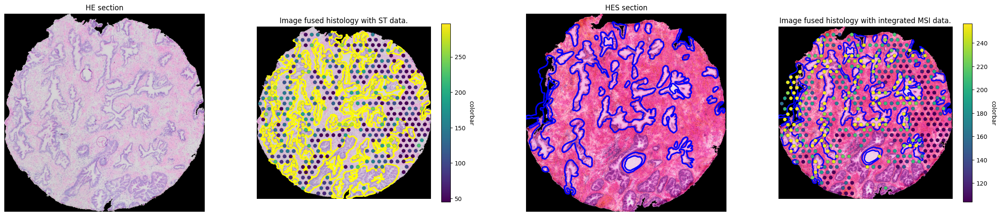

In [29]:
# st_hist = st_section.image.data.copy()
# st_hist = st_section.image.data.copy()
# st_hist = apply_mask(st_hist, st_segmentation_mask)

fig, axs = plt.subplots(1, 4, figsize=(30, 6))
for ax in axs:
    ax.axis('off')
axs[0].imshow(st_hist)
axs[0].set_title('HE section')

axs1_st_hist = cv2.drawContours(st_hist.copy(), st_contours, -1, (255, 255, 0), 20)
axs[1].imshow(axs1_st_hist)
alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)


# citsper_mat = cv2.drawContours(citsper_mat, contours, -1, (255,0,0), 10)
ax_img = axs[1].imshow(citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[1].set_title('Image fused histology with ST data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[1], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")


# msi_hist = apply_mask(msi_section.image.data, msi_section.segmentation_mask.data)
msi_hist = apply_mask(msi_section.image.data, msi_section.get_annotations_by_names('tissue_mask').data)

msi_hist = cv2.drawContours(msi_hist.copy(), msi_contours, -1, (0,0,255), 20)
axs[2].imshow(msi_hist)
axs[2].set_title('HES section')

axs[3].imshow(msi_hist)
alpha_mat = citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citrate_mat[citrate_mat > 0], .15)
vmax = np.quantile(citrate_mat[citrate_mat > 0], .85)

ax_img = axs[3].imshow(citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[3].set_title('Image fused histology with integrated MSI data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[3], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

### Plot wrong data

In [30]:

# TODO: Rewrite this function so that it works with
core_name = '002_01'

sections = load_sections(core_name)
art_st_sections = load_artificial_sections(core_name)

st_identifier = get_st_identifier(core_name, metadata_df)

st_section = art_st_sections['2']
w_st_ref_mat= st_section.molecular_data.ref_mat.data
w_st_table = st_section.molecular_data.table.data
w_st_table.set_index('0', inplace=True)
w_st_hist = st_section.image.data
w_st_hist = apply_mask(w_st_hist, st_section.annotations[-1].data)


small_df = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
w_st_gland_mat = st_section.annotations[0].get_by_label('gland')
w_st_contours, hierarchy = cv2.findContours(w_st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

msi_section = sections['7']
msi_gland_mat = msi_section.annotations[0].get_by_label('Normal Glands')
msi_contours, hierarchy = cv2.findContours(msi_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)


# citsper_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'Citsper')
# citrate_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'met_Citrate')

w_small_df = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.core_name == core_name]
w_small_df.loc[:, 'Citsper_norm'] = min_max_normalize(w_small_df.Citsper)
w_small_df.loc[:, 'Citrate_norm'] = min_max_normalize(w_small_df.met_Citrate)
w_small_df.loc[:, 'Citsper_norm_z'] = normalize_z(w_small_df.Citsper)
w_small_df.loc[:, 'Citrate_norm_z'] = normalize_z(w_small_df.met_Citrate)
w_small_df.loc[:, 'Citrate'] = w_small_df.met_Citrate.copy()
w_small_df.shape

(308, 2514)

Text(0, 0.5, 'colorbar')

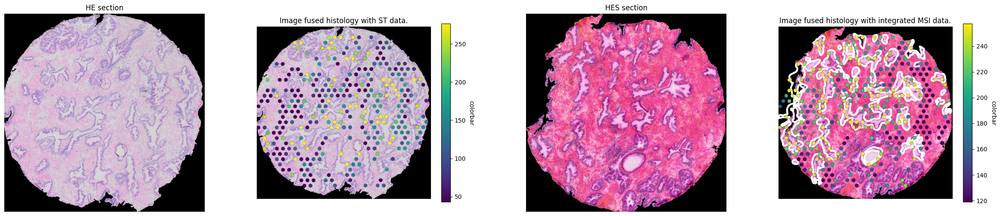

In [31]:
# et_measurement_matrix_sep(measurement_df, ref_mat, st_table, col)
# w_citsper_mat = get_measurement_matrix_sep(w_small_df, w_st_ref_mat, w_st_table, 'Citsper')
# w_citrate_mat = get_measurement_matrix_sep(w_small_df, w_st_ref_mat, w_st_table, 'Citrate')

w_st_ref_mat = w_st_ref_mat.astype(np.uint32)
w_citsper_mat = get_measurement_matrix_2(w_small_df, w_st_ref_mat, w_st_table, 'Citsper')
w_citrate_mat = get_measurement_matrix_2(w_small_df, w_st_ref_mat, w_st_table, 'Citrate')

# st_hist = st_section.image.data.copy()
# st_hist = apply_mask(st_hist, st_section.segmentation_mask.data)

fig, axs = plt.subplots(1, 4, figsize=(30, 6))
for ax in axs:
    ax.axis('off')
axs[0].imshow(w_st_hist)
axs[0].set_title('HE section')

# axs1_st_hist = cv2.drawContours(st_hist, st_contours, -1, (0, 0, 255), 20)
# axs[1].imshow(axs1_st_hist)


w_axs1_st_hist = cv2.drawContours(w_st_hist.astype(np.uint8).copy(), w_st_contours, -1, (255, 255, 255), 30)
axs[1].imshow(w_axs1_st_hist)
# axs[1].imshow(w_st_hist)
alpha_mat = w_citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citsper_mat[w_citsper_mat > 0], .15)
vmax = np.quantile(w_citsper_mat[w_citsper_mat > 0], .85)

ax_img = axs[1].imshow(w_citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[1].set_title('Image fused histology with ST data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[1], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")


msi_hist = apply_mask(msi_section.image.data, msi_section.segmentation_mask.data)

axs[2].imshow(msi_hist)
axs[2].set_title('HES section')

w_axs3_msi_hist = cv2.drawContours(msi_hist.copy(), msi_contours, -1, (255, 255, 255), 30)
axs[3].imshow(w_axs3_msi_hist)
alpha_mat = w_citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citrate_mat[w_citrate_mat > 0], .15)
vmax = np.quantile(w_citrate_mat[w_citrate_mat > 0], .85)

ax_img = axs[3].imshow(w_citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[3].set_title('Image fused histology with integrated MSI data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[3], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

In [28]:
def get_spot_coloring_img(df, ref_mat, table, col='unified_hp_class', background_color='white'):
    stroma_color = sns.color_palette()[0]
    gland_color = sns.color_palette()[1]
    spot_class_mat = get_measurement_matrix_2(df, ref_mat, table, col)
    smat = np.zeros((spot_class_mat.shape[0], spot_class_mat.shape[1], 3), dtype=np.float32)
    if background_color == 'white':
        smat += 1
    for i in range(spot_class_mat.shape[0]):
        for j in range(spot_class_mat.shape[1]):
            val = spot_class_mat[i,j]
            if val == 'Non-cancer glands':
                smat[i,j] = gland_color
            elif val == 'Stroma':
                smat[i,j] = stroma_color
    smat = (smat * 255).astype(np.uint8)
    return smat

### Plot scores one by one

Make 4 separate images:

1. Histology
2. Spots with transparent background
3. Spots with transparent background with colorbar
4. Annotations with transparent background

In [29]:
def plot_all_images_for_st_section(image, mask, measurement_mat, annotations, core_name, directory, clim_tuple=None):

    masked_image = apply_mask(image, mask)
    masked_image_square = pad_to_square(masked_image)
    meas_mat_square = pad_to_square(measurement_mat)
    ann_mat_square = pad_to_square(annotations)
    contours, hierarchy = cv2.findContours(ann_mat_square, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    black_background = np.zeros_like(meas_mat_square)
    alpha_mask_contours = cv2.drawContours(black_background, contours, -1, (255), 50).astype(np.uint8)
    # alpha_mask_contours[alpha_mask_contours > 0] = 1

    vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
    vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)
    

    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(masked_image_square)
    path = join(directory, f'{core_name}_histology.png')
    plt.savefig(path, transparent=True)
    plt.close()

    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    alpha_mask = np.zeros_like(meas_mat_square)
    alpha_mask[meas_mat_square > 0] = 1
    axs.imshow(meas_mat_square, vmin=vmin, vmax=vmax, alpha=alpha_mask, clim=clim_tuple)
    path = join(directory, f'{core_name}_measurement_mat.png')
    plt.savefig(path, transparent=True)
    plt.close()

    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    alpha_mask = np.zeros_like(meas_mat_square)
    alpha_mask[meas_mat_square > 0] = 1
    axs.imshow(meas_mat_square, vmin=vmin, vmax=vmax, alpha=alpha_mask, clim=clim_tuple)
    path = join(directory, f'{core_name}_measurement_mat_with_colorbar.png')
    cbarlabel = 'colorbar'
    cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.9)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    plt.savefig(path, transparent=True)
    plt.close()

    contour_template = np.zeros_like(masked_image_square)
    contour_template = cv2.drawContours(contour_template, contours, -1, (255, 255, 255), 50).astype(np.uint8)
    # print(contour_template.shape, contour_template.dtype)
    img = Image.fromarray(contour_template)
    img.putalpha(Image.fromarray(alpha_mask_contours))
    img.save(join(directory, f'{core_name}_contours.png'))

In [34]:
label_path = '../configs/integration/annotations/new_labels.txt'
msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'
# core_name = '004_02'
# core_name = '002_01'
core_name = '045_03'
# core_name = '048_02'

config_path = f'../configs/cores_hr/{core_name}.json'
st_identifier = get_st_identifier(core_name, metadata_df)
# integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
st_section_path = join(integration_root_dir, core_name, '2')
img_path = join(st_section_path, 'image.nii.gz')
ref_mat_path = join(st_section_path, 'moldata', 'index_mask.nii.gz')
tissue_mask_path = join(st_section_path, 'mask.nii.gz')
table_path = join(st_section_path, 'moldata', 'table.csv')

st_image = sitk.GetArrayFromImage(sitk.ReadImage(img_path))
st_ref_mat = sitk.GetArrayFromImage(sitk.ReadImage(ref_mat_path))
st_segmentation_mask = sitk.GetArrayFromImage(sitk.ReadImage(tissue_mask_path))
st_table = pd.read_csv(table_path, index_col=0)
st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
st_gland_mat = st_annotations.data[:,:,8]
st_contours, hierarchy = cv2.findContours(st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
msi_section = RegGraph.from_config_path(config_path, remove_additional_data=True, filter_ids=[7]).sections[7]
sections = {
    7: msi_section
}
with open(config_path) as f:
    config = json.load(f)
    msi_name = [x for x in config['sections'] if x['id'] == 7][0]['name']
    msi_hist_path = join(msi_histopathology_path, msi_name + '.nii.gz')
    msi_annotations = sitk.GetArrayFromImage(sitk.ReadImage(msi_hist_path))
    # print(msi_annotations.shape)
    msi_annotations = np.moveaxis(msi_annotations, 0, 2)
    with open(label_path) as f:
        labels = [x.strip() for x in f.readlines()]
    msi_named_ann = Annotation(data=msi_annotations, labels=labels)
    msi_section.annotations = [msi_named_ann]

msi_gland_annotation = msi_section.annotations[0].data[:,:,2]
msi_contours, hierarchy = cv2.findContours(msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
small_df = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
small_df.loc[:, 'Citsper_norm'] = min_max_normalize(small_df.Citsper)
small_df.loc[:, 'Citrate_norm'] = min_max_normalize(small_df.met_Citrate)
small_df.loc[:, 'Citsper_norm_z'] = normalize_z(small_df.Citsper)
small_df.loc[:, 'Citrate_norm_z'] = normalize_z(small_df.met_Citrate)
small_df.loc[:, 'Citrate'] = small_df.met_Citrate.copy()

citsper_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'Citsper')
citrate_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'Citrate')

target_directory = 'images/citsper_citrate_analysis/new_fusion_images/'
plot_all_images_for_st_section(st_image, st_segmentation_mask, citsper_mat, st_gland_mat, core_name, target_directory)

# plot_all_images_for_core(st_image,
#                              st_segmentation_mask,
#                              st_gland_mat,
#                              st_ref_mat,
#                              st_table,
#                              msi_image,
#                              msi_segmentation_mask,
#                              msi_gland_mat,
#                              measurement_mat,
#                              sub_df,
#                              feature_list,
#                              core_name,
#                              directory,
#                              clim_tuple)

FileNotFoundError: [Errno 2] No such file or directory: '../configs/cores_hr/045_03.json'

In [30]:
def plot_all_images_for_core(st_image,
                             st_segmentation_mask,
                             st_gland_mat,
                             st_ref_mat,
                             st_table,
                             msi_image,
                             msi_segmentation_mask,
                             msi_gland_mat,
                             measurement_mat,
                             sub_df,
                             feature_list,
                             core_name,
                             directory,
                             clim_tuple,
                             sub_df_matching,
                             use_black_background=False,
                             save_plots=True):

    all_images = {}
    st_masked_image = apply_mask(st_image, st_segmentation_mask)
    st_masked_image_square = pad_to_square(st_masked_image)
    msi_masked_image = apply_mask(msi_image, msi_segmentation_mask)
    msi_masked_image_square = pad_to_square(msi_masked_image)
    # measurement_mat = measurement_mat.astype(np.uint8)
    measurement_mat = apply_mask(measurement_mat, st_segmentation_mask)
    # print('in small functino')
    # print(measurement_mat.shape)
    # print(measurement_mat.dtype)
    meas_mat_square = pad_to_square(measurement_mat)

    st_ann_mat_square = pad_to_square(st_gland_mat)
    st_contours, _ = cv2.findContours(st_ann_mat_square, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    st_black_background = np.zeros_like(meas_mat_square).astype(np.uint8)
    # print('meas_mat_square')
    # print(meas_mat_square.shape, meas_mat_square.dtype)
    st_alpha_mask_contours = cv2.drawContours(st_black_background, st_contours, -1, (255), 30).astype(np.uint8)

    msi_ann_mat_square = pad_to_square(msi_gland_mat)
    msi_contours, _ = cv2.findContours(msi_ann_mat_square, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    msi_black_background = np.zeros_like(meas_mat_square).astype(np.uint8)
    msi_alpha_mask_contours = cv2.drawContours(msi_black_background, msi_contours, -1, (255), 30).astype(np.uint8)
    # alpha_mask_contours[alpha_mask_contours > 0] = 1
    # csgs_color_img = get_spot_coloring_img(small_df, st_ref_mat, st_table)
    # wrong_csgs_color_img = get_spot_coloring_img(w_small_df, w_st_rmat, w_st_table)
    # st_color_img = get_spot_coloring_img(sub_df, st_ref_mat, st_table)
    # st_color_img_matching = get_spot_coloring_img(sub_df_matching, st_ref_mat, st_table)
    st_color_img = get_spot_coloring_img(sub_df, meas_mat_square, st_table)
    st_color_img_matching = get_spot_coloring_img(sub_df_matching, meas_mat_square, st_table)
    st_color_img_black = get_spot_coloring_img(sub_df, meas_mat_square, st_table, background_color='black')
    st_color_img_matching_black = get_spot_coloring_img(sub_df_matching, meas_mat_square, st_table, background_color='black')
    # msi_color_img = get_spot_coloring_img(measurement_mat, st_ref_mat, st_table)
    
    # m_mat = images_to_plot_wrong['045_03']['spot_color_image']
    # s_mat = images_to_plot_wrong['045_03']['spot_color_image_matching']
    st_color_img_diff_matching = st_color_img_matching.copy()
    sc_diff_mat = (st_color_img[:,:,0] != st_color_img_matching[:,:,0]) | (st_color_img[:,:,1] != st_color_img_matching[:,:,1]) | (st_color_img[:,:,2] != st_color_img_matching[:,:,2])
    for i in range(sc_diff_mat.shape[0]):
        for j in range(sc_diff_mat.shape[1]):
            if sc_diff_mat[i,j] == True:
                st_color_img_diff_matching[i,j] = np.array([0,0,0])

    print('ST Histology')
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(st_masked_image_square)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_histology.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['st_masked_image_square'] = st_masked_image_square

    print('ST Histology with contours')
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    st_masked_image_square_w_c = st_masked_image_square.copy()
    print('Shape: ', st_masked_image_square_w_c.shape, st_masked_image_square_w_c.dtype)
    st_masked_image_square_w_c = cv2.drawContours(st_masked_image_square_w_c, st_contours, -1, (255, 255, 255), 30)
    axs.imshow(st_masked_image_square)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_histology_with_contour.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['st_masked_image_square_w_c'] = st_masked_image_square_w_c
    
    print('MSI Histology')
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(msi_masked_image_square)
    fig.tight_layout()
    path = join(directory, f'{core_name}_msi_histology.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['msi_masked_image_square'] = msi_masked_image_square
    
    print('ST stroma contours')
    st_contour_template = np.zeros_like(st_masked_image_square)
    st_contour_template = cv2.drawContours(st_contour_template, st_contours, -1, (255, 255, 255), 30).astype(np.uint8)
    # print(contour_template.shape, contour_template.dtype)
    st_img = Image.fromarray(st_contour_template)
    st_img.putalpha(Image.fromarray(st_alpha_mask_contours))
    if save_plots:
        st_img.save(join(directory, f'{core_name}_st_stroma_contours.png'))
    all_images['st_contour_template'] = st_contour_template
    
    print('MSI stroma contours')
    msi_contour_template = np.zeros_like(msi_masked_image_square)
    msi_contour_template = cv2.drawContours(msi_contour_template, msi_contours, -1, (255, 255, 255), 30).astype(np.uint8)
    # print(contour_template.shape, contour_template.dtype)
    msi_img = Image.fromarray(msi_contour_template)
    msi_img.putalpha(Image.fromarray(msi_alpha_mask_contours))
    if save_plots:
        msi_img.save(join(directory, f'{core_name}_msi_stroma_contours.png'))
    all_images['msi_contour_template'] = msi_contour_template

    print('Color of spots image')
    fig, axs = plt.subplots(1, 1, figsize=(8,8))
    axs.axis('off')
    axs.imshow(st_color_img)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_spot_image.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['spot_color_image'] = st_color_img
    
    print('Color of spots image black')
    fig, axs = plt.subplots(1, 1, figsize=(8,8))
    axs.axis('off')
    axs.imshow(st_color_img)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_spot_image_black.png')
    print(f'path image black: {path}')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['spot_color_image_black'] = st_color_img
    
    print('Color of spots matching image')
    fig, axs = plt.subplots(1, 1, figsize=(8,8))
    axs.axis('off')
    axs.imshow(st_color_img_matching)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_spot_image_matching.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['spot_color_image_matching'] = st_color_img_matching
    
    print('Color of spots matching image black')
    fig, axs = plt.subplots(1, 1, figsize=(8,8))
    axs.axis('off')
    axs.imshow(st_color_img_matching_black)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_spot_image_matching_black.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['spot_color_image_matching_black'] = st_color_img_matching_black
    
    print('Color of spots matching image with missing')
    fig, axs = plt.subplots(1, 1, figsize=(8,8))
    axs.axis('off')
    axs.imshow(st_color_img_diff_matching)
    fig.tight_layout()
    path = join(directory, f'{core_name}_st_spot_image_matching_diff.png')
    if save_plots:
        plt.savefig(path, transparent=True)
    plt.close()
    all_images['spot_color_image_matching_diff'] = st_color_img_diff_matching
    
    all_images['sub_df'] = sub_df
    all_images['meas_mat_square'] = meas_mat_square
    all_images['st_table'] = st_table

    all_images['sub_df_matching'] = sub_df_matching

    print('Features')
    for _, feature in enumerate(feature_list):

        print(feature)
        print('non matching tissue')
        feature_meas_mat = get_measurement_matrix_2(sub_df, meas_mat_square, st_table, feature)
        # vmin = np.quantile(feature_meas_mat[feature_meas_mat > 0], .15)
        # vmax = np.quantile(feature_meas_mat[feature_meas_mat > 0], .85)
        vmin, vmax = get_vmin_vmax(feature_meas_mat)
        
        fig, axs = plt.subplots(1, 1, figsize=(8, 8))
        axs.axis('off')
        alpha_mask = np.zeros_like(feature_meas_mat)
        alpha_mask[feature_meas_mat != 0] = 1
        if use_black_background:
            black_background = np.zeros_like(feature_meas_mat)
            axs.imshow(black_background)
        axs.imshow(feature_meas_mat, vmin=vmin, vmax=vmax, alpha=alpha_mask, clim=clim_tuple)
        fig.tight_layout()
        # cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.8, location='top')
        # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
        # cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=24)
        # cbar.ax.tick_params(labelsize=20)
        path = join(directory, f'{core_name}_{feature}.png')
        if save_plots:
            plt.savefig(path, transparent=True)
        plt.close()
        all_images[f'{feature}_meas_mat'] = feature_meas_mat

        fig, axs = plt.subplots(1, 1, figsize=(8, 8))
        axs.axis('off')
        if use_black_background:
            black_background = np.zeros_like(feature_meas_mat)
            axs.imshow(black_background)
        ax_img = axs.imshow(feature_meas_mat, vmin=vmin, vmax=vmax, alpha=alpha_mask, clim=clim_tuple)
        cbar = ax_img.figure.colorbar(ax_img, ax=axs, shrink=.8, location='top')
        cbar.ax.tick_params(labelsize=20)
        fig.tight_layout()
        path = join(directory, f'{core_name}_{feature}_colorbar.png')
        # cbarlabel = 'colorbar'
        # cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.9)
        # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
        if save_plots:
            plt.savefig(path, transparent=True)
        plt.close()
         
        print('Matching tissue')
        feature_meas_mat = get_measurement_matrix_2(sub_df_matching, meas_mat_square, st_table, feature)
        # vmin = np.quantile(feature_meas_mat[feature_meas_mat > 0], .15)
        # vmax = np.quantile(feature_meas_mat[feature_meas_mat > 0], .85)
        vmin, vmax = get_vmin_vmax(feature_meas_mat)
        
        fig, axs = plt.subplots(1, 1, figsize=(8, 8))
        axs.axis('off')
        alpha_mask = np.zeros_like(feature_meas_mat)
        alpha_mask[feature_meas_mat != 0] = 1
        if use_black_background:
            black_background = np.zeros_like(feature_meas_mat)
            axs.imshow(black_background)
        axs.imshow(feature_meas_mat, vmin=vmin, vmax=vmax, alpha=alpha_mask, clim=clim_tuple)
        fig.tight_layout()
        # cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.8, location='top')
        # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
        # cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=24)
        # cbar.ax.tick_params(labelsize=20)
        path = join(directory, f'{core_name}_{feature}_match_tiss.png')
        if save_plots:
            plt.savefig(path, transparent=True)
        plt.close()
        all_images[f'{feature}_meas_mat_matching'] = feature_meas_mat

        fig, axs = plt.subplots(1, 1, figsize=(8, 8))
        axs.axis('off')
        if use_black_background:
            black_background = np.zeros_like(feature_meas_mat)
            axs.imshow(black_background)
        ax_img = axs.imshow(feature_meas_mat, vmin=vmin, vmax=vmax, alpha=alpha_mask, clim=clim_tuple)
        cbar = ax_img.figure.colorbar(ax_img, ax=axs, shrink=.8, location='top')
        cbar.ax.tick_params(labelsize=20)
        fig.tight_layout()
        path = join(directory, f'{core_name}_{feature}_match_tiss_colorbar.png')
        # cbarlabel = 'colorbar'
        # cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.9)
        # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
        if save_plots:
            plt.savefig(path, transparent=True)
        plt.close()

    all_images['st_ref_mat'] = st_ref_mat
    all_images['st_mask'] = st_segmentation_mask
    return all_images

def load_and_plot_for_core(core_name, save_plots=True):
    # label_path = '../configs/integration/annotations/new_labels.txt'
    # msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'

    target_directory = '../../images/citsper_citrate_analysis/new_fusion_images/'
    sections = load_sections(core_name)
    st_section = sections['2']
    st_image = st_section.image.data
    st_ref_mat = st_section.molecular_data.ref_mat.data
    st_segmentation_mask = st_section.get_annotations_by_names('tissue_mask').data
    st_table = st_section.molecular_data.table.data
    st_table.set_index('0', inplace=True)
    st_annotations = st_section.annotations[0]
    st_gland_mat = st_annotations.get_by_label('gland')
    msi_section = sections['7']
    msi_gland_annotation = msi_section.annotations[0].get_by_label('Normal Glands')
    msi_segmentation_mask = msi_section.get_annotations_by_names('tissue_mask')
    # # config_path = f'../configs/cores_hr/{core_name}.json'
    # # st_identifier = get_st_identifier(core_name, metadata_df)
    # # # integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
    # # integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
    # # st_section_path = join(integration_root_dir, core_name, '2')
    # # img_path = join(st_section_path, 'image.nii.gz')
    # # ref_mat_path = join(st_section_path, 'moldata', 'index_mask.nii.gz')
    # # tissue_mask_path = join(st_section_path, 'mask.nii.gz')
    # # table_path = join(st_section_path, 'moldata', 'table.csv')

    # st_image = sitk.GetArrayFromImage(sitk.ReadImage(img_path))
    # st_ref_mat = sitk.GetArrayFromImage(sitk.ReadImage(ref_mat_path))
    # st_segmentation_mask = sitk.GetArrayFromImage(sitk.ReadImage(tissue_mask_path))
    # st_table = pd.read_csv(table_path, index_col=0)
    # st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
    # st_gland_mat = st_annotations.data[:,:,8]
    # st_contours, hierarchy = cv2.findContours(st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # # msi_section = RegGraph.from_config_path(config_path, remove_additional_data=True, filter_ids=[7]).sections[7]
    # # sections = {
    # #     7: msi_section
    # # }
    # with open(config_path) as f:
    #     config = json.load(f)
    #     msi_name = [x for x in config['sections'] if x['id'] == 7][0]['name']
    #     msi_hist_path = join(msi_histopathology_path, msi_name + '.nii.gz')
    #     msi_annotations = sitk.GetArrayFromImage(sitk.ReadImage(msi_hist_path))
    #     # print(msi_annotations.shape)
    #     msi_annotations = np.moveaxis(msi_annotations, 0, 2)
    #     with open(label_path) as f:
    #         labels = [x.strip() for x in f.readlines()]
    #     msi_named_ann = Annotation(data=msi_annotations, labels=labels)
    #     msi_section.annotations = [msi_named_ann]

    # msi_gland_annotation = msi_section.annotations[0].data[:,:,2]
    # # msi_contours, hierarchy = cv2.findContours(msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # small_df = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
    sub_df = spot_annotations_df_merged[spot_annotations_df_merged.core_name == core_name]

    # plot_all_images_for_st_section(st_image, st_segmentation_mask, citsper_mat, st_gland_mat, core_name, target_directory)

    msi_image = msi_section.image.data.copy()
    msi_segmentation_mask = msi_section.segmentation_mask.data.copy()
    msi_gland_mat = msi_gland_annotation
    measurement_mat = st_ref_mat.copy()
    # sub_df = small_df.copy()
    # sub_df.set_index('barcode', inplace=True)
    feature_list = ['Citsper', 'met_Citrate', 'met_Zinc', 'Spermine']
    clim_tuple=None

    # integrated_base_dir = '/mnt/scratch/maximilw/multiomics_integration/integrated_datasets_st_maldi_positive'
    # pos_df = pd.read_csv(join(integrated_base_dir, core_name, 'integrated_data.csv'), index_col=0)
    # sub_df = sub_df.merge(pos_df, left_index=True, right_index=True)
    # sub_df['barcode'] = sub_df.index

    sub_df = spot_annotations_df_merged[spot_annotations_df_merged.core_name == core_name]
    sub_df['copy_barcode_index'] = sub_df['barcode']
    sub_df.set_index('copy_barcode_index', inplace=True)
    # integrated_base_dir = '/mnt/scratch/maximilw/multiomics_integration/integrated_datasets_st_maldi_positive'
    # pos_df = pd.read_csv(join(integrated_base_dir, core_name, 'integrated_data.csv'), index_col=0)['Spermine']
    pos_df = pd.read_csv(f'/mnt/scratch/maximilw/data/registered_spatial_multiomics_samples/{core_name}/msi_pos/integrated_data.csv', index_col=0)['Spermine']

    sub_df['Spermine'] = pos_df
    
    sub_df_matching = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
    sub_df_matching['copy_barcode_index'] = sub_df_matching['barcode']
    sub_df_matching.set_index('copy_barcode_index', inplace=True)
    # integrated_base_dir = '/mnt/scratch/maximilw/multiomics_integration/integrated_datasets_st_maldi_positive'
    # pos_df = pd.read_csv(join(integrated_base_dir, core_name, 'integrated_data.csv'), index_col=0)['Spermine']
    pos_df = pd.read_csv(f'/mnt/scratch/maximilw/data/registered_spatial_multiomics_samples/{core_name}/msi_pos/integrated_data.csv', index_col=0)['Spermine']
    sub_df_matching['Spermine'] = pos_df

    # msi_pos_root_dir = '/mnt/scratch/maximilw/data/multiomics_integration/st_maldi_pos_integration/'
    # msi_pos_section = Section.load(join(msi_pos_root_dir, core_name, 'maldi_pos_section_new_2'))

    all_images = plot_all_images_for_core(st_image,
                             st_segmentation_mask,
                             st_gland_mat,
                             st_ref_mat,
                             st_table,
                             msi_image,
                             msi_segmentation_mask,
                             msi_gland_mat,
                             measurement_mat,
                             sub_df,
                             feature_list,
                             core_name,
                             target_directory,
                             clim_tuple,
                             sub_df_matching,
                             use_black_background=True,
                             save_plots=save_plots)
    return all_images

def load_and_plot_for_wrong_core(core_name, save_plots=False):
    target_directory = '../../images/citsper_citrate_analysis/new_fusion_images_wrong/'
    # wrong_target_dir = f'/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180/{core_name}/rotated_data'
    # label_path = '../configs/integration/annotations/new_labels.txt'
    # msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'
    # # core_name = '004_02'
    # # core_name = '045_03'
    # # core_name = '003_02'

    # config_path = f'../configs/cores_hr/{core_name}.json'
    # st_identifier = get_st_identifier(core_name, metadata_df)
    # # integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
    # integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
    # st_section_path = join(integration_root_dir, core_name, '2')
    # w_st_table = pd.read_csv(join(st_section_path, 'moldata', 'table.csv'), index_col=0)

    # w_st_hist = sitk.ReadImage(join(wrong_target_dir, 'target_img.png'))
    # w_st_hist = sitk.GetArrayFromImage(w_st_hist).astype(np.uint8)
    # w_st_mask = sitk.ReadImage(join(wrong_target_dir, 'target_seg_mask_new.nii.gz'))
    # w_st_mask = sitk.GetArrayFromImage(w_st_mask).astype(np.uint8)
    # w_st_hist = apply_mask(w_st_hist, w_st_mask)

    # w_st_rmat = sitk.ReadImage(join(wrong_target_dir, 'target_rmat_new.nii.gz'))
    # w_st_rmat = sitk.GetArrayFromImage(w_st_rmat)
    # w_st_rmat = w_st_rmat.astype(int)
    # w_st_rmat = apply_mask(w_st_rmat, w_st_mask)

    artificial_sections = load_artificial_sections(core_name)
    sections = load_sections(core_name)
    st_section = artificial_sections['2']
    w_st_hist = st_section.image.data
    w_st_mask = st_section.annotations[-1].data.astype(np.uint8)
    w_st_hist = apply_mask(w_st_hist, w_st_mask).astype(np.uint8)

    w_st_rmat = st_section.molecular_data.ref_mat.data.astype(np.uint32)
    w_st_table = st_section.molecular_data.table.data
    w_st_table.set_index('0', inplace=True)

    w_st_annotations = st_section.annotations[0]
    w_st_annotations.labels = sections['2'].annotations[0].labels
    w_st_gland_mat = w_st_annotations.get_by_label('gland').astype(np.uint8)

    # w_st_annotations = art_st_section.annotations[0]
    # w_st_annotations.labels = st_section.annotations[0].labels
    # w_st_gland_mat = w_st_annotations.get_by_label('gland')

    w_msi_gland_annotation = sections['7'].annotations[0].get_by_label('Normal Glands')
    # w_msi_gland_annotation = sections['7'].annotations[0].data[:,:,2].astype(np.uint8)
    w_msi_section = sections['7']
    # w_st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
    # w_st_gland_mat = w_st_annotations.data[:,:,8]
    # w_st_gland_mat = rotate_image(pad_to_square(w_st_annotations.data[:,:,8])).astype(np.uint8)
    # w_st_contours, hierarchy = cv2.findContours(w_st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # w_msi_section = RegGraph.from_config_path(config_path, filter_ids=[7], remove_additional_data=True).sections[7]
    # sections = {
    #     7: w_msi_section
    # }
    # with open(config_path) as f:
    #     config = json.load(f)
    #     msi_name = [x for x in config['sections'] if x['id'] == 7][0]['name']
    #     msi_hist_path = join(msi_histopathology_path, msi_name + '.nii.gz')
    #     msi_annotations = sitk.GetArrayFromImage(sitk.ReadImage(msi_hist_path))
    #     # print(msi_annotations.shape)
    #     msi_annotations = np.moveaxis(msi_annotations, 0, 2)
    #     with open(label_path) as f:
    #         labels = [x.strip() for x in f.readlines()]
    #     msi_named_ann = Annotation(data=msi_annotations, labels=labels)
    #     w_msi_section.annotations = [msi_named_ann]

    # w_msi_gland_annotation = w_msi_section.annotations[0].data[:,:,2].astype(np.uint8)
    # w_msi_contours, hierarchy = cv2.findContours(w_msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)




    w_msi_image = w_msi_section.image.data.copy()
    w_msi_segmentation_mask = w_msi_section.get_annotations_by_names('tissue_mask').data.astype(np.uint8)
    # w_msi_segmentation_mask = w_msi_section.segmentation_mask.data.copy().astype(np.uint8)
    w_msi_gland_mat = w_msi_gland_annotation
    w_measurement_mat = w_st_rmat.copy()

    # integrated_base_dir = '/mnt/scratch/maximilw/multiomics_integration/integrated_datasets_st_maldi_positive'
    # integrated_base_dir = '/mnt/scratch/maximilw/data/global_integration_files/merged_st_msi_pos.csv'

    w_sub_df = w_spot_annotations_df_merged[w_spot_annotations_df_merged.core_name == core_name]
    w_sub_df['copy_barcode_index'] = w_sub_df['barcode']
    w_sub_df.set_index('copy_barcode_index', inplace=True)
    # pos_df = pd.read_csv(join(integrated_base_dir, core_name, 'integrated_data.csv'), index_col=0)['Spermine']
    pos_df = pd.read_csv(f'/mnt/scratch/maximilw/data/registered_spatial_multiomics_samples/{core_name}/msi_pos/integrated_data.csv', index_col=0)['Spermine']
    w_sub_df['Spermine'] = pos_df
    
    w_sub_df_matching = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.core_name == core_name]
    w_sub_df_matching['copy_barcode_index'] = w_sub_df_matching['barcode']
    w_sub_df_matching.set_index('copy_barcode_index', inplace=True)
    # pos_df = pd.read_csv(join(integrated_base_dir, core_name, 'integrated_data.csv'), index_col=0)['Spermine']
    pos_df = pd.read_csv(f'/mnt/scratch/maximilw/data/registered_spatial_multiomics_samples/{core_name}/msi_pos/integrated_data.csv', index_col=0)['Spermine']
    w_sub_df_matching['Spermine'] = pos_df

    feature_list = ['Citsper', 'met_Citrate', 'met_Zinc', 'Spermine']
    clim_tuple=None

    # msi_pos_root_dir = '/mnt/scratch/maximilw/data/multiomics_integration/st_maldi_pos_integration/'
    # w_msi_pos_section = Section.load(join(msi_pos_root_dir, core_name, 'maldi_pos_section_new_2'))

    all_images = plot_all_images_for_core(w_st_hist,
                             w_st_mask,
                             w_st_gland_mat,
                             w_st_rmat,
                             w_st_table,
                             w_msi_image,
                             w_msi_segmentation_mask,
                             w_msi_gland_mat,
                             w_measurement_mat,
                             w_sub_df,
                             feature_list,
                             core_name,
                             target_directory,
                             clim_tuple,
                             w_sub_df_matching,
                             use_black_background=True,
                             save_plots=save_plots)
    return all_images

def get_alpha(img):
    alpha_mask = np.zeros_like(img)
    alpha_mask[img != 0] = 1
    return alpha_mask


def plot_collage(img_correct, img_wrong, use_vmin=True, use_vmax=True, use_white_background=True):
    
    fig, axs = plt.subplots(4, 5, figsize=(8*5, 8*4))
    fig.set_facecolor('black')
    for i in range(axs.shape[0]):
        for j in range(axs.shape[1]):
            axs[i,j].axis('off')
    
    axs[0, 0].imshow(img_correct['spot_color_image'])
    axs[1, 0].imshow(img_correct['spot_color_image_matching'])
    axs[2, 0].imshow(img_wrong['spot_color_image'])
    axs[3, 0].imshow(img_wrong['spot_color_image_matching'])
        
    
    cimg = img_correct['Citsper_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[0, 1].imshow(black_background)
    ax= axs[0, 1].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)
    # cbar = ax.figure.colorbar(ax_img, ax=ax, shrink=.8, location='top')
    # cbar.ax.tick_params(labelsize=20)
    cimg = img_correct['Citsper_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[1, 1].imshow(black_background)
    ax= axs[1, 1].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)
    # cbar = ax.figure.colorbar(ax_img, ax=ax, shrink=.8, location='top')
    # cbar.ax.tick_params(labelsize=20)
    cimg = img_wrong['Citsper_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[2, 1].imshow(black_background)
    ax= axs[2, 1].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)
    # cbar = ax.figure.colorbar(ax_img, ax=ax, shrink=.8, location='top')
    # cbar.ax.tick_params(labelsize=20)
    cimg = img_wrong['Citsper_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[3, 1].imshow(black_background)
    ax= axs[3, 1].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)
    # cbar = ax.figure.colorbar(ax_img, ax=ax, shrink=.8, location='top')
    # cbar.ax.tick_params(labelsize=20)
    
    
    cimg = img_correct['met_Citrate_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[0, 2].imshow(black_background)
    ax= axs[0, 2].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_correct['met_Citrate_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[1, 2].imshow(black_background)
    ax= axs[1, 2].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_wrong['met_Citrate_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[2, 2].imshow(black_background)
    ax= axs[2, 2].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_wrong['met_Citrate_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[3, 2].imshow(black_background)
    ax= axs[3, 2].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)
    

    cimg = img_correct['met_Zinc_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[0, 3].imshow(black_background)
    ax= axs[0, 3].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_correct['met_Zinc_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[1, 3].imshow(black_background)
    ax= axs[1, 3].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_wrong['met_Zinc_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[2, 3].imshow(black_background)
    ax= axs[2, 3].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_wrong['met_Zinc_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[3, 3].imshow(black_background)
    ax= axs[3, 3].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)
    

    cimg = img_correct['Spermine_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[0, 4].imshow(black_background)
    ax= axs[0, 4].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_correct['Spermine_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[1, 4].imshow(black_background)
    ax= axs[1, 4].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    # WARNING! Need to use img_correct here, becuase Spermine is not mapped correctly to meas mat. And wrong registration is done on the ST section anyway.
    cimg = img_correct['Spermine_meas_mat'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[2, 4].imshow(black_background)
    ax= axs[2, 4].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax)


    cimg = img_wrong['Spermine_meas_mat_matching'].copy()
    black_background = np.zeros_like(cimg)
    if use_white_background:
        black_background = np.ones((cimg.shape[0], cimg.shape[1], 3))
    mask = get_alpha(cimg)
    vmin, vmax = get_vmin_vmax(cimg)
    if not use_vmin:
        vmin = None
    if not use_vmax:
        vmax = None
    axs[3, 4].imshow(black_background)
    ax= axs[3, 4].imshow(cimg, alpha=mask, vmin=vmin, vmax=vmax) 
    fig.tight_layout()


In [35]:
# all_images = load_and_plot_for_core('045_03', save_plots=False)
# all_images.keys()
# mat = all_images['met_Zinc_meas_mat']
# mat.min(), mat.max()
# sub_df = all_images['sub_df']

In [31]:
core_names = ['001_04', '002_01', '003_02', '004_03', '045_03', '047_04', '048_02']
images_to_plot = {}
for core_name in core_names:
    print(core_name)
    images_to_plot[core_name] = load_and_plot_for_core(core_name, save_plots=True)
    # break

001_04


ST Histology
ST Histology with contours
Shape:  (2865, 2865, 3) uint8
MSI Histology
ST stroma contours
MSI stroma contours
Color of spots image
Color of spots image black
path image black: ../../images/citsper_citrate_analysis/new_fusion_images/001_04_st_spot_image_black.png
Color of spots matching image
Color of spots matching image black
Color of spots matching image with missing
Features
Citsper
non matching tissue
Matching tissue
met_Citrate
non matching tissue
Matching tissue
met_Zinc
non matching tissue
Matching tissue
Spermine
non matching tissue
Matching tissue
002_01
ST Histology
ST Histology with contours
Shape:  (2856, 2856, 3) uint8
MSI Histology
ST stroma contours
MSI stroma contours
Color of spots image
Color of spots image black
path image black: ../../images/citsper_citrate_analysis/new_fusion_images/002_01_st_spot_image_black.png
Color of spots matching image
Color of spots matching image black
Color of spots matching image with missing
Features
Citsper
non matching ti

In [32]:
core_names = ['001_04', '002_01', '003_02', '004_03', '045_03', '047_04', '048_02']
images_to_plot_wrong = {}
for core_name in core_names:
    print(core_name)
    images_to_plot_wrong[core_name] = load_and_plot_for_wrong_core(core_name, save_plots=True)

001_04


ST Histology
ST Histology with contours
Shape:  (2865, 2865, 3) uint8
MSI Histology
ST stroma contours
MSI stroma contours
Color of spots image
Color of spots image black
path image black: ../../images/citsper_citrate_analysis/new_fusion_images_wrong/001_04_st_spot_image_black.png
Color of spots matching image
Color of spots matching image black
Color of spots matching image with missing
Features
Citsper
non matching tissue
Matching tissue
met_Citrate
non matching tissue
Matching tissue
met_Zinc
non matching tissue
Matching tissue
Spermine
non matching tissue
Matching tissue
002_01
ST Histology
ST Histology with contours
Shape:  (2856, 2856, 3) uint8
MSI Histology
ST stroma contours
MSI stroma contours
Color of spots image
Color of spots image black
path image black: ../../images/citsper_citrate_analysis/new_fusion_images_wrong/002_01_st_spot_image_black.png
Color of spots matching image
Color of spots matching image black
Color of spots matching image with missing
Features
Citsper
non

In [33]:
art_sections = load_artificial_sections('045_03')
art_st_section = art_sections['2']

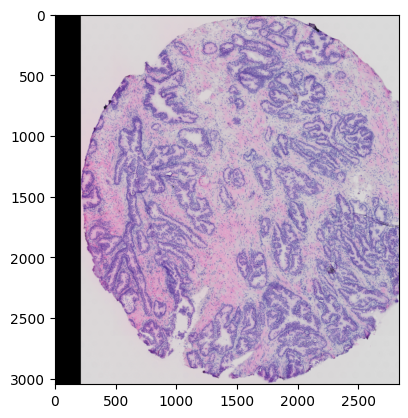

In [43]:
rmat = art_st_section.molecular_data.ref_mat.data
plt.imshow(art_st_section.image.data)

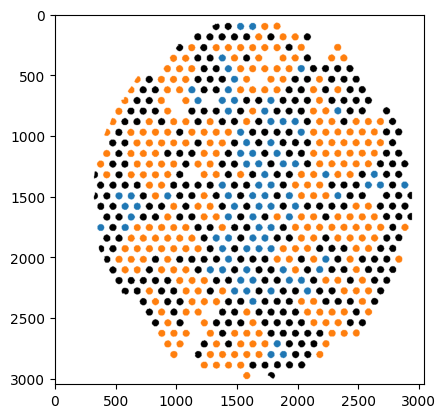

In [67]:
m_mat = images_to_plot_wrong['045_03']['spot_color_image']
s_mat = images_to_plot_wrong['045_03']['spot_color_image_matching']
s_mat2 = s_mat.copy()
sc_diff_mat = (m_mat[:,:,0] != s_mat[:,:,0]) | (m_mat[:,:,1] != s_mat[:,:,1]) | (m_mat[:,:,2] != s_mat[:,:,2])
for i in range(sc_diff_mat.shape[0]):
    for j in range(sc_diff_mat.shape[1]):
        if sc_diff_mat[i,j] == True:
            s_mat2[i,j] = np.array([0,0,0])
            
# collapsed_spot_color_img = collapsed_spot_color_img[:,:,0] 
plt.imshow(s_mat2)

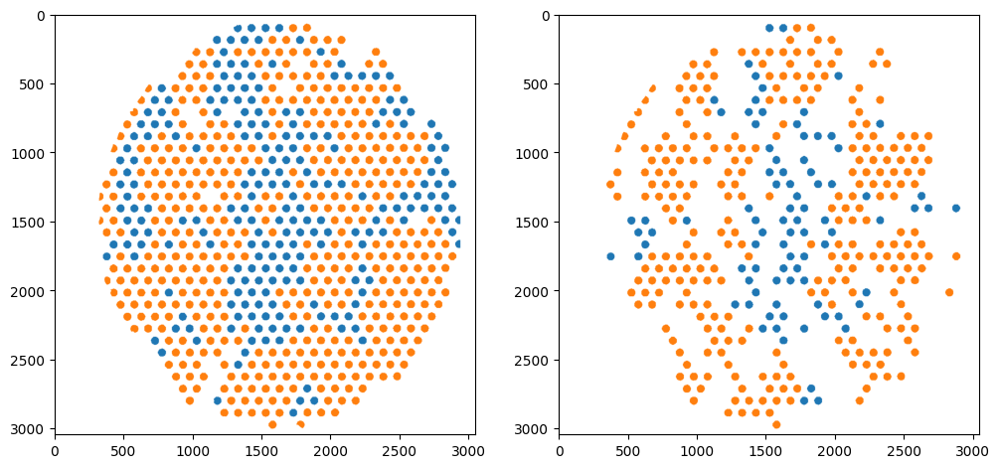

In [64]:
m_mat = images_to_plot_wrong['045_03']['spot_color_image']
s_mat = images_to_plot_wrong['045_03']['spot_color_image_matching']
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(m_mat)
axs[1].imshow(s_mat)

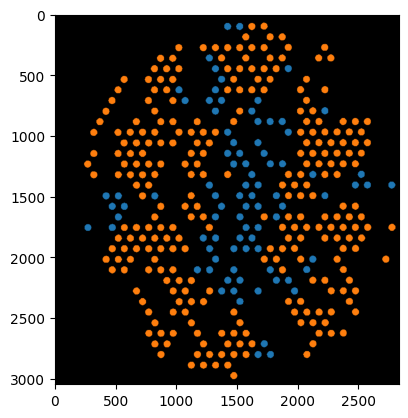

In [38]:
# plt.imshow(images_to_plot_wrong['045_03']['st_masked_image_square'])
plt.imshow(images_to_plot_wrong['045_03']['spot_color_image_matching'])

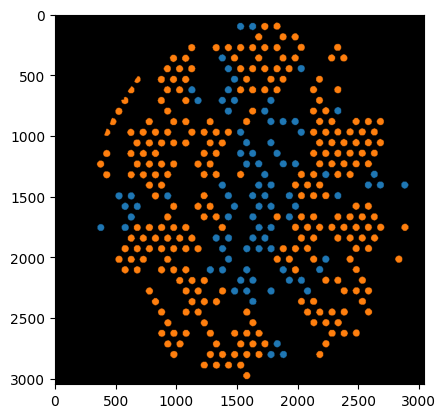

In [99]:
sub_df_matching = images_to_plot_wrong['045_03']['sub_df_matching']
ref_mat = images_to_plot_wrong['045_03']['meas_mat_square']
st_table = images_to_plot_wrong['045_03']['st_table']
img = get_spot_coloring_img(sub_df_matching, ref_mat, st_table)
plt.imshow(img)

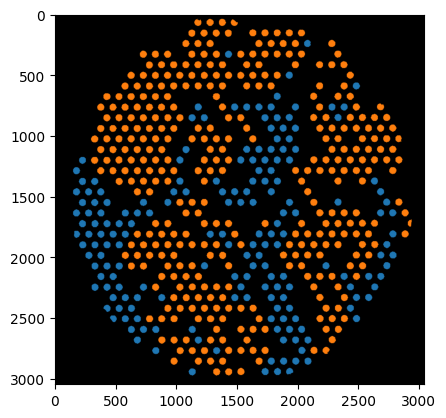

In [98]:

sub_df_matching = images_to_plot['045_03']['sub_df_matching']
ref_mat = images_to_plot['045_03']['meas_mat_square']
st_table = images_to_plot['045_03']['st_table']
img = get_spot_coloring_img(sub_df_matching, ref_mat, st_table)
plt.imshow(img)

In [39]:
# core_name = '045_03'
core_names = ['001_04', '002_01', '003_02', '004_03', '045_03', '047_04', '048_02']
for core_name in core_names:
    print(core_name)
    plot_collage(images_to_plot[core_name], images_to_plot_wrong[core_name], use_vmin=True, use_vmax=True)
    plt.savefig(f'../../images/citsper_citrate_analysis/collages/collage_{core_name}.png')
    plt.close()

001_04
002_01
003_02
004_03
045_03
047_04
048_02


In [ ]:
# Plot for experiment 2
fig, axs = plt.subplots(2, 2, figsize=(64, 64))
for i in range(axs.shape[0]):
    for j in range(axs.shape[1]):
        axs.axis('off')
axs[0,0].imshow(images_to_plot['0'])

In [34]:
# core_name = '045_03'
def plot_spot_images_before_and_after_tissue_matching(core_name):
    sections = load_sections(core_name)
    st_section = sections['2']
    st_ref_mat = st_section.molecular_data.ref_mat.data.astype(np.uint32)
    st_table = st_section.molecular_data.table.data
    st_table.set_index('0', inplace=True)
    # integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
    # st_section_path = join(integration_root_dir, core_name, '2')
    # ref_mat_path = join(st_section_path, 'moldata', 'index_mask.nii.gz')
    # table_path = join(st_section_path, 'moldata', 'table.csv')
    # st_table = pd.read_csv(table_path, index_col=0)
    sub_df_nonmatching = spot_annotations_df_merged[spot_annotations_df_merged.core_name == core_name]
    sub_df_matching = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
    # st_ref_mat = sitk.GetArrayFromImage(sitk.ReadImage(ref_mat_path))
    st_nonmatching_color_img = get_spot_coloring_img(sub_df_nonmatching, st_ref_mat, st_table)
    st_matching_color_img = get_spot_coloring_img(sub_df_matching, st_ref_mat, st_table)
    st_color_img_diff_matching = st_matching_color_img.copy()
    sc_diff_mat = (st_nonmatching_color_img[:,:,0] != st_matching_color_img[:,:,0]) | (st_nonmatching_color_img[:,:,1] != st_matching_color_img[:,:,1]) | (st_nonmatching_color_img[:,:,2] != st_matching_color_img[:,:,2])
    for i in range(sc_diff_mat.shape[0]):
        for j in range(sc_diff_mat.shape[1]):
            if sc_diff_mat[i,j] == True:
                st_color_img_diff_matching[i,j] = np.array([0,0,0])

    msi_nonmatching_color_img = get_spot_coloring_img(sub_df_nonmatching, st_ref_mat, st_table, 'msi_hist')
    
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(st_color_img_diff_matching)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_diff_image.png')
    plt.savefig(path, transparent=True)
    plt.close()
    
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(st_nonmatching_color_img)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_st_nonmatching_correct.png')
    plt.savefig(path, transparent=True)
    plt.close()
    
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(st_matching_color_img)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_st_matching_correct.png')
    plt.savefig(path, transparent=True)
    plt.close()
    
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(msi_nonmatching_color_img)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_msi_matching_correct.png')
    plt.savefig(path, transparent=True)
    plt.close()

    
    # Now do wrong data
    art_sections = load_artificial_sections(core_name)
    art_st_section = art_sections['2']

    w_st_table = art_st_section.molecular_data.table.data
    w_st_table.set_index('0', inplace=True)

    w_st_mask = art_st_section.annotations[-1].data.astype(np.uint8)
    w_st_ref_mat = art_st_section.molecular_data.ref_mat.data.astype(np.uint32)

    # wrong_target_dir = f'/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180/{core_name}/rotated_data'
    # integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
    # st_section_path = join(integration_root_dir, core_name, '2')
    # w_st_table = pd.read_csv(join(st_section_path, 'moldata', 'table.csv'), index_col=0)

    # w_st_mask = sitk.ReadImage(join(wrong_target_dir, 'target_seg_mask_new.nii.gz'))
    # w_st_mask = sitk.GetArrayFromImage(w_st_mask).astype(np.uint8)

    # w_st_ref_mat = sitk.ReadImage(join(wrong_target_dir, 'target_rmat_new.nii.gz'))
    # w_st_ref_mat = sitk.GetArrayFromImage(w_st_ref_mat)
    # w_st_ref_mat = w_st_ref_mat.astype(int)
    w_st_ref_mat = apply_mask(w_st_ref_mat, w_st_mask)
    
    w_matching_small_df = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.core_name == core_name]
    w_nonmatching_small_df = w_spot_annotations_df_merged[w_spot_annotations_df_merged.core_name == core_name]
    
    w_st_nonmatching_color_img = get_spot_coloring_img(w_nonmatching_small_df, w_st_ref_mat, w_st_table)
    w_st_matching_color_img = get_spot_coloring_img(w_matching_small_df, w_st_ref_mat, w_st_table)
    w_msi_nonmatching_color_img = get_spot_coloring_img(w_nonmatching_small_df, w_st_ref_mat, w_st_table, 'msi_hist')

    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(w_st_nonmatching_color_img)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_st_nonmatching_wrong.png')
    plt.savefig(path, transparent=True)
    plt.close()
    
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(w_st_matching_color_img)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_st_matching_wrong.png')
    plt.savefig(path, transparent=True)
    plt.close()
    
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(w_msi_nonmatching_color_img)
    fig.tight_layout()
    path = join(f'../../images/citsper_citrate_analysis/spot_images/{core_name}_msi_matching_wrong.png')
    plt.savefig(path, transparent=True)
    plt.close()

    

In [35]:
core_names = ['001_04', '002_01', '003_02', '004_03', '045_03', '047_04', '048_02']
# images_to_plot = {}
for core_name in core_names:
    print(core_name)
    plot_spot_images_before_and_after_tissue_matching(core_name)
    # images_to_plot[core_name] = load_and_plot_for_wrong_core(core_name)

001_04


002_01
003_02
004_03
045_03
047_04
048_02


In [ ]:
images_to_plot['001_04'].keys()

dict_keys(['st_masked_image_square', 'st_masked_image_square_w_c', 'msi_masked_image_square', 'st_contour_template', 'msi_contour_template', 'Citsper_meas_mat', 'Citrate_meas_mat', 'met_Zinc_meas_mat', 'Spermine_meas_mat'])

In [109]:
core_images.keys()

dict_keys(['st_masked_image_square', 'st_masked_image_square_w_c', 'msi_masked_image_square', 'st_contour_template', 'msi_contour_template', 'spot_color_image', 'spot_color_image_matching', 'sub_df', 'meas_mat_square', 'st_table', 'sub_df_matching', 'Citsper_meas_mat', 'Citsper_meas_mat_matching', 'met_Citrate_meas_mat', 'met_Citrate_meas_mat_matching', 'met_Zinc_meas_mat', 'met_Zinc_meas_mat_matching', 'Spermine_meas_mat', 'Spermine_meas_mat_matching', 'st_ref_mat', 'st_mask'])

In [110]:
len(images_to_plot)

7

In [111]:
images_to_plot.keys()

dict_keys(['001_04', '002_01', '003_02', '004_03', '045_03', '047_04', '048_02'])

In [112]:
core_images.keys()

dict_keys(['st_masked_image_square', 'st_masked_image_square_w_c', 'msi_masked_image_square', 'st_contour_template', 'msi_contour_template', 'spot_color_image', 'spot_color_image_matching', 'sub_df', 'meas_mat_square', 'st_table', 'sub_df_matching', 'Citsper_meas_mat', 'Citsper_meas_mat_matching', 'met_Citrate_meas_mat', 'met_Citrate_meas_mat_matching', 'met_Zinc_meas_mat', 'met_Zinc_meas_mat_matching', 'Spermine_meas_mat', 'Spermine_meas_mat_matching', 'st_ref_mat', 'st_mask'])

In [113]:
clim_citrate_max = 0
clim_zinc_max = 0
clim_spermine_max = 0
clim_citsper_max = 0
for idx, core_name in enumerate(images_to_plot):
    core_images = images_to_plot[core_name]
    clim_citrate_max = max(clim_citrate_max, core_images['Citsper_meas_mat'].max())
    clim_zinc_max = max(clim_zinc_max, core_images['met_Zinc_meas_mat'].max())
    clim_spermine_max = max(clim_spermine_max, core_images['Spermine_meas_mat'].max())
    clim_citsper_max = max(clim_citsper_max, core_images['Citsper_meas_mat'].max())

for idx, core_name in enumerate(images_to_plot):
    print(core_name)
    print('st_image')
    core_images = images_to_plot[core_name]
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    axs.imshow(core_images['st_masked_image_square'])
    plt.savefig(f'../../images/citsper_citrate_analysis/new_fusion_images2/{core_name}_st_hist.png', transparent=True)
    plt.close()
    
    print('st_image_contour')
    fig, axs = plt.subplots(1, 1, figsize=(8, 8))
    axs.axis('off')
    # img = core_images['st_masked_image_square_w_c']
    # contour = core_images['st_contour_template']
    # contour_mask = contour.sum(2)
    # contour_mask[contour_mask > 0] = 1
    # contour_mask = contour_mask.astype(np.uint8)
    axs.imshow(core_images['st_masked_image_square_w_c'])
    # axs.imshow(contour, alpha=contour_mask)
    plt.savefig(f'../../images/citsper_citrate_analysis/new_fusion_images2/{core_name}_st_hist_with_contour.png', transparent=True)
    plt.close()

    # vmin = cit
    # vmin = np.quantile(citsper_meas_mat[citsper_meas_mat != 0], .15)
    # vmax = np.quantile(citsper_meas_mat[citsper_meas_mat != 0], .85)
    print('citsper')
    fig, axs = plt.subplots(1, 1, figsize=(10, 8))
    axs.axis('off')
    citsper_meas_mat = core_images['Citsper_meas_mat']
    vmin, vmax = get_vmin_vmax(citsper_meas_mat)
    alpha_mask = np.zeros_like(citsper_meas_mat)
    alpha_mask[citsper_meas_mat != 0] = 1
    axs.imshow(np.zeros_like(citsper_meas_mat))
    ax_img = axs.imshow(citsper_meas_mat, alpha=alpha_mask, vmin=vmin, vmax=vmax)
    cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.8, location='top')
    cbarlabel = 'CSGS score'
    cbar.ax.tick_params(labelsize=20)
    cbar.ax.set_ylabel(cbarlabel, rotation=0, va="top", fontsize=20)
    plt.savefig(f'../../images/citsper_citrate_analysis/new_fusion_images2/{core_name}_citsper_meas_mat.png', transparent=True)
    plt.close()
    
    print('citrate')
    fig, axs = plt.subplots(1, 1, figsize=(10, 8))
    axs.axis('off')
    vmin, vmax = get_vmin_vmax(core_images['met_Citrate_meas_mat'])
    ax_img = axs.imshow(core_images['met_Citrate_meas_mat'], vmin=vmin, vmax=vmax)
    cbarlabel = 'Citrate levels'
    cbar = axs.figure.colorbar(ax_img, shrink=1)
    cbar.ax.tick_params(labelsize=20)
    cbar.ax.set_ylabel(cbarlabel, rotation=0, va="top", fontsize=20)
    # cbar.ax.tick_params(labelsize=18)
    # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", fontsize=20)
    plt.savefig(f'../../images/citsper_citrate_analysis/new_fusion_images2/{core_name}_citrate_meas_mat.png', transparent=True)
    plt.close()

    print('zinc')
    fig, axs = plt.subplots(1, 1, figsize=(10, 8))
    axs.axis('off')
    vmin, vmax = get_vmin_vmax(core_images['met_Zinc_meas_mat'])
    ax_img = axs.imshow(core_images['met_Zinc_meas_mat'], vmin=vmin, vmax=vmax)
    cbarlabel = 'Zinc levels'
    cbar = axs.figure.colorbar(ax_img, shrink=1)
    cbar.ax.tick_params(labelsize=20)
    cbar.ax.set_ylabel(cbarlabel, rotation=0, va="top", fontsize=20)
    # cbar = axs.figure.colorbar(ax_img, shrink=1)
    # cbar.ax.tick_params(labelsize=18)
    # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", fontsize=20)
    plt.savefig(f'../../images/citsper_citrate_analysis/new_fusion_images2/{core_name}_zinc_meas_mat.png', transparent=True)
    plt.close()

    print('spermine')
    fig, axs = plt.subplots(1, 1, figsize=(10, 8))
    axs.axis('off')
    vmin, vmax = get_vmin_vmax(core_images['Spermine_meas_mat'])
    ax_img = axs.imshow(core_images['Spermine_meas_mat'], vmin=vmin, vmax=vmax)
    cbarlabel = 'Spermine levels'
    cbar = axs.figure.colorbar(ax_img, shrink=1)
    cbar.ax.tick_params(labelsize=20)
    cbar.ax.set_ylabel(cbarlabel, rotation=0, va="top", fontsize=20)
    # cbar = axs.figure.colorbar(ax_img, shrink=1)
    # cbar.ax.tick_params(labelsize=18)
    # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", fontsize=20)
    plt.savefig(f'../../images/citsper_citrate_analysis/new_fusion_images2/{core_name}_spermine_meas_mat.png', transparent=True)
    plt.close()
# plt.savefig('images/')

001_04
st_image
st_image_contour
citsper
citrate
zinc
spermine
002_01
st_image
st_image_contour
citsper
citrate
zinc
spermine
003_02
st_image
st_image_contour
citsper
citrate
zinc
spermine
004_03
st_image
st_image_contour
citsper
citrate
zinc
spermine
045_03
st_image
st_image_contour
citsper
citrate
zinc
spermine
047_04
st_image
st_image_contour
citsper
citrate
zinc
spermine
048_02
st_image
st_image_contour
citsper
citrate
zinc
spermine


Text(0, 0.5, 'Spermine levels')

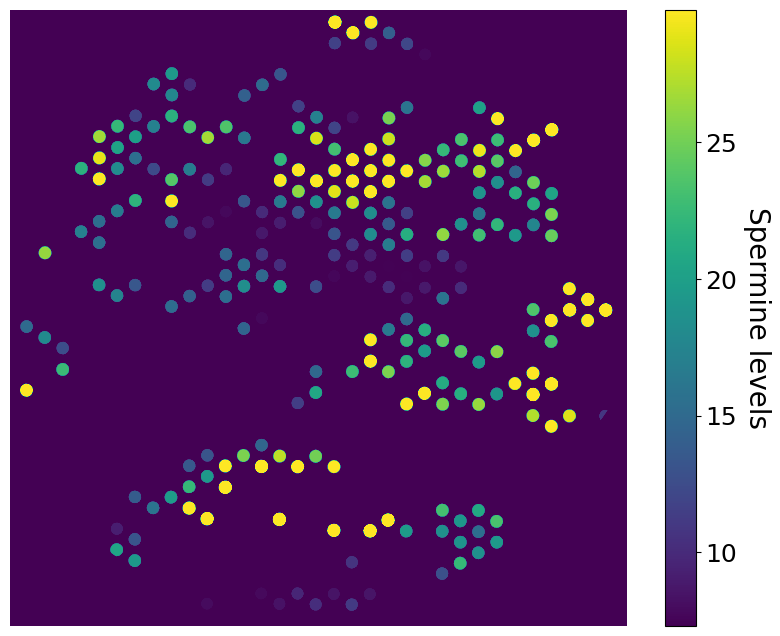

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(10, 8))
axs.axis('off')
vmin, vmax = get_vmin_vmax(core_images['Spermine_meas_mat'])
ax_img = axs.imshow(core_images['Spermine_meas_mat'], vmin=vmin, vmax=vmax)
cbarlabel = 'Spermine levels'
cbar = axs.figure.colorbar(ax_img, shrink=1)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", fontsize=20)

Text(0, 0.5, 'Zinc levels')

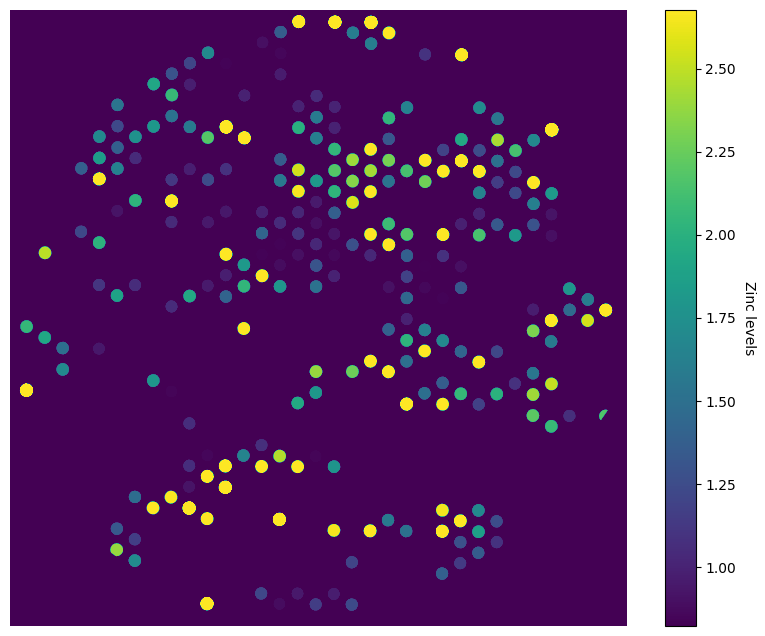

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(10, 8))
axs.axis('off')
vmin, vmax = get_vmin_vmax(core_images['met_Zinc_meas_mat'])
ax_img = axs.imshow(core_images['met_Zinc_meas_mat'], vmin=vmin, vmax=vmax)
cbarlabel = 'Zinc levels'
cbar = axs.figure.colorbar(ax_img, shrink=1)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

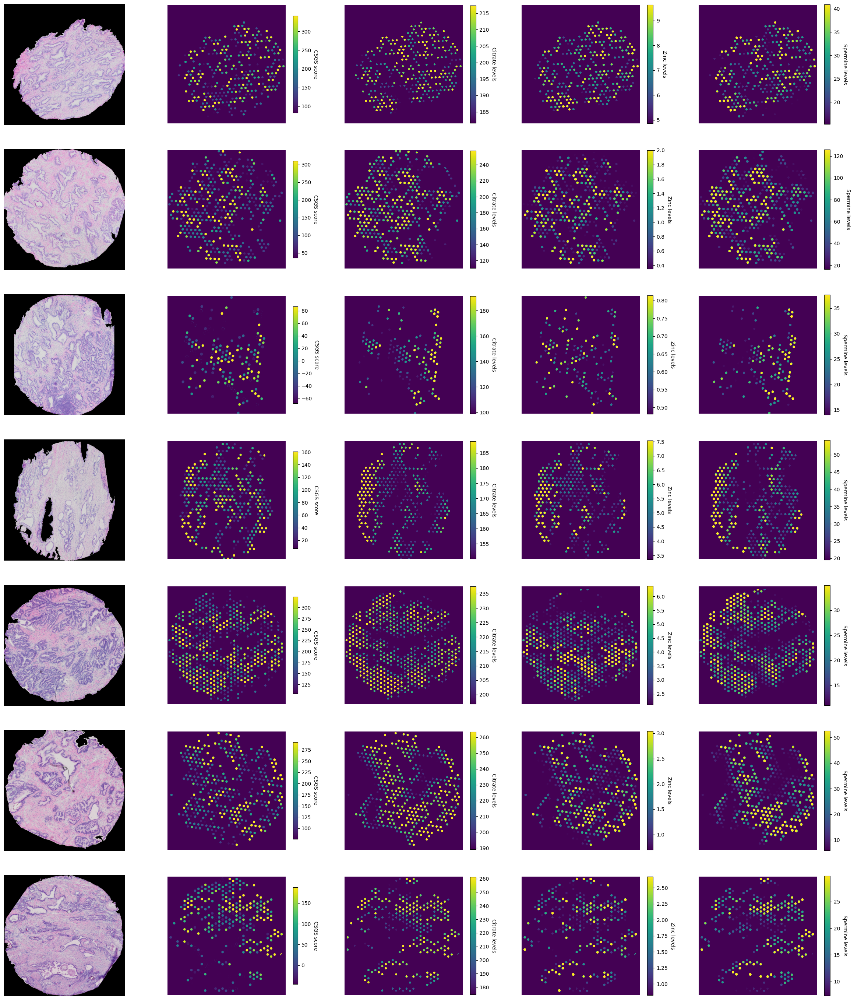

In [ ]:
fig, axs = plt.subplots(7, 5, figsize=(30, 35))
for i in range(axs.shape[0]):
    for j in range(axs.shape[1]):
        axs[i,j].axis('off')
clim_citrate_max = 0
clim_zinc_max = 0
clim_spermine_max = 0
clim_citsper_max = 0
for idx, core_name in enumerate(images_to_plot):
    core_images = images_to_plot[core_name]
    clim_citrate_max = max(clim_citrate_max, core_images['Citsper_meas_mat'].max())
    clim_zinc_max = max(clim_zinc_max, core_images['met_Zinc_meas_mat'].max())
    clim_spermine_max = max(clim_spermine_max, core_images['Spermine_meas_mat'].max())
    clim_citsper_max = max(clim_citsper_max, core_images['Citsper_meas_mat'].max())
for idx, core_name in enumerate(images_to_plot):
    core_images = images_to_plot[core_name]
    axs[idx, 0].imshow(core_images['st_masked_image_square'])
    citsper_meas_mat = core_images['Citsper_meas_mat']
    # vmin = cit
    # vmin = np.quantile(citsper_meas_mat[citsper_meas_mat != 0], .15)
    # vmax = np.quantile(citsper_meas_mat[citsper_meas_mat != 0], .85)
    vmin, vmax = get_vmin_vmax(citsper_meas_mat)
    alpha_mask = np.zeros_like(citsper_meas_mat)
    alpha_mask[citsper_meas_mat != 0] = 1
    axs[idx, 1].imshow(np.zeros_like(citsper_meas_mat))
    ax_img = axs[idx, 1].imshow(citsper_meas_mat, alpha=alpha_mask, vmin=vmin, vmax=vmax)
    cbarlabel = 'CSGS score'
    cbar = axs[idx, 1].figure.colorbar(ax_img, shrink=.98)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    # axs[idx, 1].imshow(core_images['Citsper_meas_mat'])
    vmin, vmax = get_vmin_vmax(core_images['Citrate_meas_mat'])
    ax_img = axs[idx, 2].imshow(core_images['Citrate_meas_mat'], vmin=vmin, vmax=vmax)
    cbarlabel = 'Citrate levels'
    cbar = axs[idx, 2].figure.colorbar(ax_img, shrink=.98)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    vmin, vmax = get_vmin_vmax(core_images['met_Zinc_meas_mat'])
    ax_img = axs[idx, 3].imshow(core_images['met_Zinc_meas_mat'], vmin=vmin, vmax=vmax)
    cbarlabel = 'Zinc levels'
    cbar = axs[idx, 3].figure.colorbar(ax_img, shrink=.98)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    vmin, vmax = get_vmin_vmax(core_images['Spermine_meas_mat'])
    ax_img = axs[idx, 4].imshow(core_images['Spermine_meas_mat'], vmin=vmin, vmax=vmax)
    cbarlabel = 'Spermine levels'
    cbar = axs[idx, 4].figure.colorbar(ax_img, shrink=.98)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
# plt.savefig('images/')

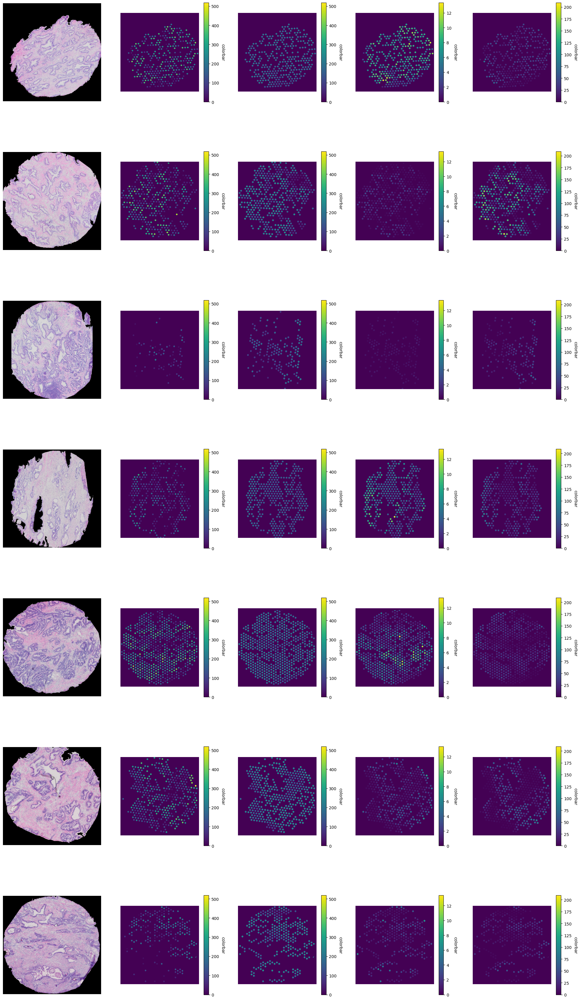

In [ ]:
fig, axs = plt.subplots(7, 5, figsize=(25, 45))
for i in range(axs.shape[0]):
    for j in range(axs.shape[1]):
        axs[i,j].axis('off')
clim_citrate_max = 0
clim_zinc_max = 0
clim_spermine_max = 0
clim_citsper_max = 0
for idx, core_name in enumerate(images_to_plot):
    core_images = images_to_plot[core_name]
    clim_citrate_max = max(clim_citrate_max, core_images['Citsper_meas_mat'].max())
    clim_zinc_max = max(clim_zinc_max, core_images['met_Zinc_meas_mat'].max())
    clim_spermine_max = max(clim_spermine_max, core_images['Spermine_meas_mat'].max())
    clim_citsper_max = max(clim_citsper_max, core_images['Citsper_meas_mat'].max())
for idx, core_name in enumerate(images_to_plot):
    core_images = images_to_plot[core_name]
    axs[idx, 0].imshow(core_images['st_masked_image_square'])
    citsper_meas_mat = core_images['Citsper_meas_mat']
    alpha_mask = np.zeros_like(citsper_meas_mat)
    alpha_mask[citsper_meas_mat != 0] = 1
    axs[idx, 1].imshow(np.zeros_like(citsper_meas_mat))
    ax_img = axs[idx, 1].imshow(citsper_meas_mat, alpha=alpha_mask, clim=(0, clim_citsper_max))
    cbarlabel = 'colorbar'
    cbar = axs[idx, 1].figure.colorbar(ax_img, shrink=.8)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    # axs[idx, 1].imshow(core_images['Citsper_meas_mat'])
    ax_img = axs[idx, 2].imshow(core_images['Citrate_meas_mat'], clim=(0, clim_citrate_max))
    cbarlabel = 'colorbar'
    cbar = axs[idx, 2].figure.colorbar(ax_img, shrink=.8)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    ax_img = axs[idx, 3].imshow(core_images['met_Zinc_meas_mat'], clim=(0, clim_zinc_max))
    cbarlabel = 'colorbar'
    cbar = axs[idx, 3].figure.colorbar(ax_img, shrink=.8)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    ax_img = axs[idx, 4].imshow(core_images['Spermine_meas_mat'], clim=(0, clim_spermine_max))
    cbarlabel = 'colorbar'
    cbar = axs[idx, 4].figure.colorbar(ax_img, shrink=.8)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    

In [ ]:
g = RegGraph.from_config_path(config_path, remove_additional_data=, filter_ids=[6, 7])

In [ ]:
# st1 = Section.load('/mnt/scratch/maximilw/data/multiomics_integration/st_maldi_pos_integration/003_01/2_3_6/warped_st_section')
os.listdir('/mnt/scratch/maximilw/data/multiomics_integration/st_maldi_pos_integration/003_02/best_warped_st_section')
pos_df

,Choline,Creatine,Acetylcholine,Spermidine,Carnitine,Phosphocholine,Spermine,Acetylcarnitine,Butyryl‐L‐carnitine,Hydroxybutyrylcarnitine,...,PC (36:4),PC (36:2),PC (36:1),PC (36:4)_1,PC (36:3),PC (36:2)_1,PC (36:1)_1,PC (38:4),PC (38:4)_1,PC (38:3)
TCGCTAAACCGCTATC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GGAAAGTGCCCATGCC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
TCTTACCGGAACTCGT-1,7.838674,2.123191,0.481977,0.138207,1.090714,12.772697,5.466248,1.335300,0.412410,0.268500,...,3.355092,5.850009,6.193142,3.866448,3.011863,3.962763,3.227593,3.314874,2.278738,1.539070
TTCCAATCAGAGCTAG-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
CTCAGTCACGACAAAT-1,26.540813,7.931023,1.690044,0.822404,4.107007,6.921444,15.267899,4.728834,1.204390,0.229902,...,1.987717,7.427060,8.825892,3.047761,4.539510,9.199746,8.761697,1.378905,1.745834,2.090719
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTATTCATGTGTCCCA-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
GAAACCGAATTACCTT-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
TATTCCACTCAGCTCG-1,34.571571,25.146482,1.901203,0.740373,9.082105,14.561661,11.570358,5.545345,0.794643,0.683701,...,6.748513,27.142621,14.753288,2.790713,3.490754,10.634890,4.472616,7.657734,2.216501,2.917760
GCCCGATCTGTGGTCG-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


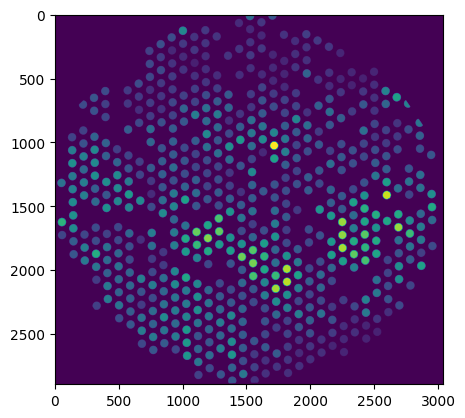

In [ ]:

citsper_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'met_Zinc')
plt.imshow(citsper_mat)

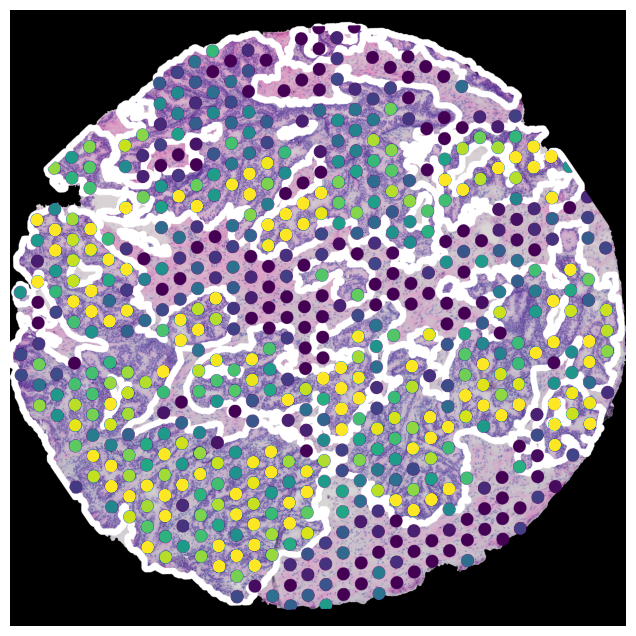

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')

# Correct data, st section
st_hist = st_image.copy()
st_hist = apply_mask(st_hist, st_segmentation_mask)
st_hist = pad_to_square(st_hist)
citsper_mat = pad_to_square(citsper_mat)
msi_hist = pad_to_square(msi_hist)
citrate_mat = pad_to_square(citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())


# st_hist_w_gland_annotation = 
# color = (48, 213, 200)
# color = (0, 0, 250)
color = (255, 255, 255)
st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
st_gland_mat = pad_to_square(st_annotations.data[:,:,8])
st_contours, hierarchy = cv2.findContours(st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
st_hist_w_gland_annotation = cv2.drawContours(st_hist, st_contours, -1, color, 30)
axs.imshow(st_hist_w_gland_annotation)
# axs.imshow(st_hist)
# axs[0].imshow(st_hist)
alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)

ax_img = axs.imshow(citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citsper_clim, max_citsper_clim))

# cbarlabel = 'Citsper Gene Scores'
# cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
# cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=22)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_2nd_correct_st_no_label.png', transparent=True)

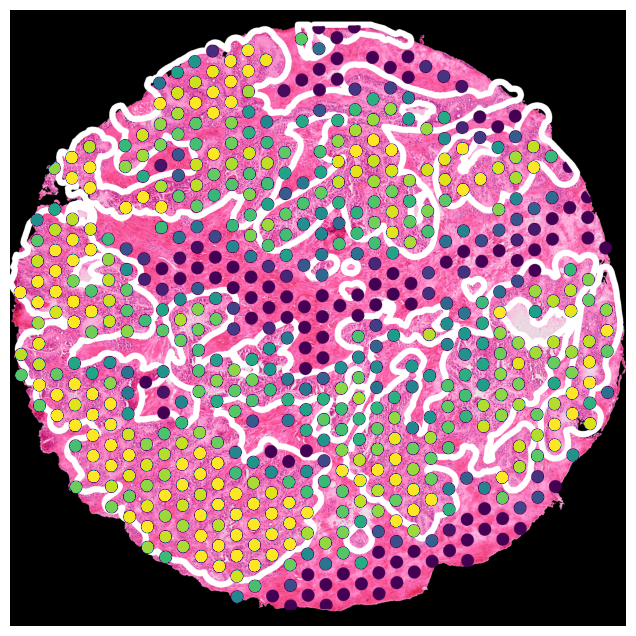

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')

# Correct data, st section

msi_hist = apply_mask(msi_section.image.data, msi_section.segmentation_mask.data)
msi_hist = cv2.drawContours(msi_hist.copy(), msi_contours, -1, color, 30)
msi_hist = pad_to_square(msi_hist)
citrate_mat = pad_to_square(citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())


# axs[0].imshow(st_hist)
alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)

# axs[0].set_title('Correct: Histology fused with ST data.')

cbarlabel = 'Citsper Gene Scores'
# Correct data, msi section

msi_gland_annotation = pad_to_square(msi_section.annotations[0].data[:,:,2])
msi_contours, hierarchy = cv2.findContours(msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
msi_hist_w_gland_annotation = cv2.drawContours(msi_hist, msi_contours, -1, color, 30)
axs.imshow(msi_hist_w_gland_annotation)
# axs.imshow(msi_hist)
alpha_mat = citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citrate_mat[citrate_mat > 0], .15)
vmax = np.quantile(citrate_mat[citrate_mat > 0], .85)

ax_img = axs.imshow(citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citrate_clim, max_citrate_clim))
# axs[1].set_title('Correct: Histology fused with integrated MSI data.')

cbarlabel = 'Citrate Expression Levels'

# cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
# cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=22)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_2nd_correct_msi_no_label.png', transparent=True)

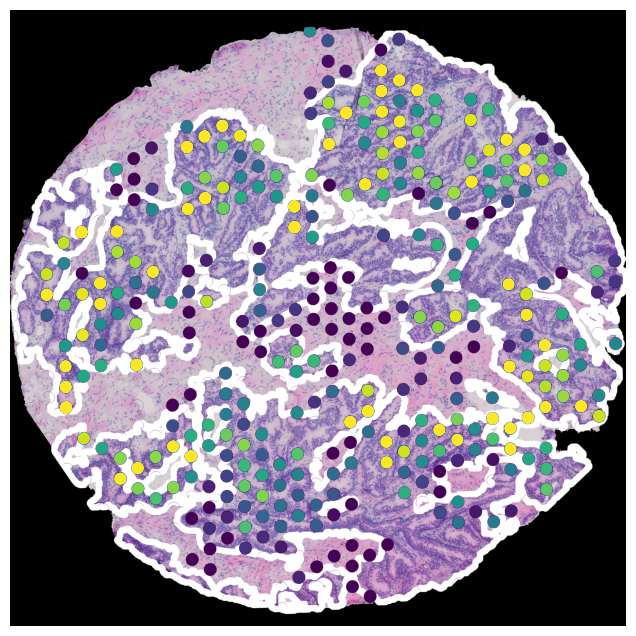

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')

# Correct data, st section
w_st_hist = pad_to_square(w_st_hist)
w_citsper_mat = pad_to_square(w_citsper_mat)

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())

alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)


# Wrong data, st section
#st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
#st_gland_mat = pad_to_square(w_st_annotations.data[:,:,8])
#st_contours, hierarchy = cv2.findContours(w_st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
#st_hist_w_gland_annotation = cv2.drawContours(w_st_hist.astype(np.uint8).copy(), w_st_contours, -1, (0, 0, 255), 20)

w_st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
# w_st_gland_mat = w_st_annotations.data[:,:,8]
w_st_gland_mat = rotate_image(pad_to_square(w_st_annotations.data[:,:,8])).astype(np.uint8)
w_st_contours, hierarchy = cv2.findContours(w_st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
st_hist_w_gland_annotation = cv2.drawContours(w_st_hist.astype(np.uint8).copy(), w_st_contours, -1, color, 30)
axs.imshow(st_hist_w_gland_annotation)
# w_axs1_st_hist = cv2.drawContours(w_st_hist.astype(np.uint8).copy(), w_st_contours, -1, (0, 0, 255), 20)
# axs[1].imshow(w_axs1_st_hist)
# axs.imshow(w_st_hist)
alpha_mat = w_citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citsper_mat[w_citsper_mat > 0], .15)
vmax = np.quantile(w_citsper_mat[w_citsper_mat > 0], .85)

ax_img = axs.imshow(w_citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citsper_clim, max_citsper_clim))
# axs[2].set_title('Wrong: Histology fused with ST data.')

# cbarlabel = 'Citsper Gene Scores'

# cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
# cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=22)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_2nd_wrong_st_no_label.png', transparent=True)

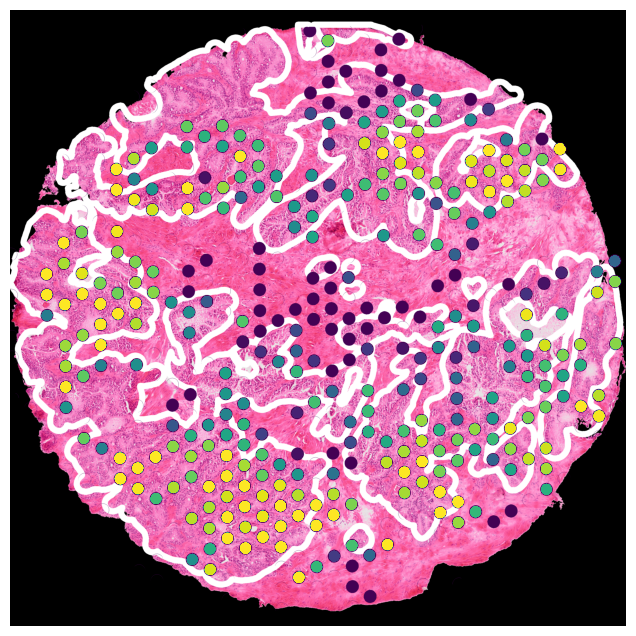

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')

# Correct data, st section
w_msi_hist = apply_mask(w_msi_section.image.data, w_msi_section.segmentation_mask.data)
w_msi_hist = pad_to_square(w_msi_hist)
w_citrate_mat = pad_to_square(w_citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())


# Wrong data, msi section
w_msi_gland_annotation = pad_to_square(w_msi_section.annotations[0].data[:,:,2])
w_msi_contours, hierarchy = cv2.findContours(w_msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
w_msi_hist_w_gland_annotation = cv2.drawContours(w_msi_hist, w_msi_contours, -1, color, 30)
axs.imshow(w_msi_hist_w_gland_annotation)
alpha_mat = w_citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citrate_mat[w_citrate_mat > 0], .15)
vmax = np.quantile(w_citrate_mat[w_citrate_mat > 0], .85)

ax_img = axs.imshow(w_citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citrate_clim, max_citrate_clim))
# axs[3].set_title('Wrong: Histology fused with integrated MSI data.')

# cbarlabel = 'Citrate Expression Levels'
# cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# # cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
# cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=22)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_2nd_wrong_msi_no_label.png', transparent=True)

### First Analysis

In [ ]:

import json
from miit.spatial_data.image import Annotation


label_path = '../configs/integration/annotations/new_labels.txt'
msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'
# core_name = '004_02'
# core_name = '002_01'
core_name = '045_03'
# core_name = '048_02'

config_path = f'../configs/cores_hr/{core_name}.json'
st_identifier = get_st_identifier(core_name, metadata_df)
# integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
st_section_path = join(integration_root_dir, core_name, '2')
img_path = join(st_section_path, 'image.nii.gz')
ref_mat_path = join(st_section_path, 'moldata', 'index_mask.nii.gz')
tissue_mask_path = join(st_section_path, 'mask.nii.gz')
table_path = join(st_section_path, 'moldata', 'table.csv')

st_image = sitk.GetArrayFromImage(sitk.ReadImage(img_path))
st_ref_mat = sitk.GetArrayFromImage(sitk.ReadImage(ref_mat_path))
st_segmentation_mask = sitk.GetArrayFromImage(sitk.ReadImage(tissue_mask_path))
st_table = pd.read_csv(table_path, index_col=0)
st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
st_gland_mat = st_annotations.data[:,:,8]
st_contours, hierarchy = cv2.findContours(st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
sections = {
    7: msi_section
}
with open(config_path) as f:
    config = json.load(f)
    msi_name = [x for x in config['sections'] if x['id'] == 7][0]['name']
    msi_hist_path = join(msi_histopathology_path, msi_name + '.nii.gz')
    msi_annotations = sitk.GetArrayFromImage(sitk.ReadImage(msi_hist_path))
    # print(msi_annotations.shape)
    msi_annotations = np.moveaxis(msi_annotations, 0, 2)
    with open(label_path) as f:
        labels = [x.strip() for x in f.readlines()]
    msi_named_ann = Annotation(data=msi_annotations, labels=labels)
    msi_section.annotations = [msi_named_ann]

msi_gland_annotation = msi_section.annotations[0].data[:,:,2]
msi_contours, hierarchy = cv2.findContours(msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
# small_df = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.core_name == core_name]
small_df = spot_annotations_df_merged_matching_f[spot_annotations_df_merged_matching_f.core_name == core_name]
small_df.loc[:, 'Citsper_norm'] = min_max_normalize(small_df.Citsper)
small_df.loc[:, 'Citrate_norm'] = min_max_normalize(small_df.met_Citrate)
small_df.loc[:, 'Citsper_norm_z'] = normalize_z(small_df.Citsper)
small_df.loc[:, 'Citrate_norm_z'] = normalize_z(small_df.met_Citrate)
small_df.loc[:, 'Citrate'] = small_df.met_Citrate.copy()
small_df.shape

Accession IMS:1000046 found with incorrect name "pixel size x". Updating name to "pixel size (x)".


(727, 2520)

Text(0, 0.5, 'colorbar')

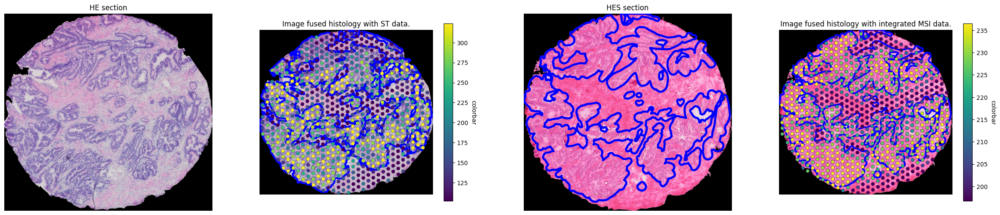

In [ ]:
citsper_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'Citsper')
citrate_mat = get_measurement_matrix_2(small_df, st_ref_mat, st_table, 'Citrate')

# st_hist = st_section.image.data.copy()
st_hist = st_image.copy()
st_hist = apply_mask(st_hist, st_segmentation_mask)

fig, axs = plt.subplots(1, 4, figsize=(30, 6))
for ax in axs:
    ax.axis('off')
axs[0].imshow(st_hist)
axs[0].set_title('HE section')

axs1_st_hist = cv2.drawContours(st_hist.copy(), st_contours, -1, (0, 0, 255), 30)
axs[1].imshow(axs1_st_hist)
alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)


# citsper_mat = cv2.drawContours(citsper_mat, contours, -1, (255,0,0), 10)
ax_img = axs[1].imshow(citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[1].set_title('Image fused histology with ST data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[1], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")


msi_hist = apply_mask(msi_section.image.data, msi_section.segmentation_mask.data)

msi_hist = cv2.drawContours(msi_hist.copy(), msi_contours, -1, (0,0,255), 30)
axs[2].imshow(msi_hist)
axs[2].set_title('HES section')

axs[3].imshow(msi_hist)
alpha_mat = citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citrate_mat[citrate_mat > 0], .15)
vmax = np.quantile(citrate_mat[citrate_mat > 0], .85)

ax_img = axs[3].imshow(citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[3].set_title('Image fused histology with integrated MSI data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[3], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")

### Plot wrong data

In [ ]:
import json
from miit.spatial_data.image import Annotation

wrong_target_dir = f'/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180/{core_name}/rotated_data'
label_path = '../configs/integration/annotations/new_labels.txt'
msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'
# core_name = '004_02'
# core_name = '045_03'
# core_name = '003_02'

config_path = f'../configs/cores_hr/{core_name}.json'
st_identifier = get_st_identifier(core_name, metadata_df)
# integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
integration_root_dir = '/mnt/scratch/maximilw/data/miit/save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1'
st_section_path = join(integration_root_dir, core_name, '2')
w_st_table = pd.read_csv(join(st_section_path, 'moldata', 'table.csv'), index_col=0)

w_st_hist = sitk.ReadImage(join(wrong_target_dir, 'target_img.png'))
w_st_hist = sitk.GetArrayFromImage(w_st_hist)
w_st_mask = sitk.ReadImage(join(wrong_target_dir, 'target_seg_mask_new.nii.gz'))
w_st_mask = sitk.GetArrayFromImage(w_st_mask)
w_st_hist = apply_mask(w_st_hist, w_st_mask)

w_st_rmat = sitk.ReadImage(join(wrong_target_dir, 'target_rmat_new.nii.gz'))
w_st_rmat = sitk.GetArrayFromImage(w_st_rmat)
w_st_rmat = w_st_rmat.astype(int)

w_st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
# w_st_gland_mat = w_st_annotations.data[:,:,8]
w_st_gland_mat = rotate_image(pad_to_square(w_st_annotations.data[:,:,8])).astype(np.uint8)
w_st_contours, hierarchy = cv2.findContours(w_st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

# w_st_section = Section.from_directory(st_section_path)
# w_st_data = w_st_section.molecular_data
# msi_section_integrated_path = join(integration_root_dir, core_name, '7')
# msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
w_msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
sections = {
    7: w_msi_section
}
with open(config_path) as f:
    config = json.load(f)
    msi_name = [x for x in config['sections'] if x['id'] == 7][0]['name']
    msi_hist_path = join(msi_histopathology_path, msi_name + '.nii.gz')
    msi_annotations = sitk.GetArrayFromImage(sitk.ReadImage(msi_hist_path))
    # print(msi_annotations.shape)
    msi_annotations = np.moveaxis(msi_annotations, 0, 2)
    with open(label_path) as f:
        labels = [x.strip() for x in f.readlines()]
    msi_named_ann = Annotation(data=msi_annotations, labels=labels)
    w_msi_section.annotations = [msi_named_ann]

w_msi_gland_annotation = w_msi_section.annotations[0].data[:,:,2]
w_msi_gland_annotation = pad_to_square(w_msi_gland_annotation)
w_msi_contours, hierarchy = cv2.findContours(w_msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    
w_small_df = w_spot_annotations_df_merged_matching_f[w_spot_annotations_df_merged_matching_f.core_name == core_name]
w_small_df.loc[:, 'Citsper_norm'] = min_max_normalize(w_small_df.Citsper)
w_small_df.loc[:, 'Citrate_norm'] = min_max_normalize(w_small_df.met_median_Citrate)
w_small_df.loc[:, 'Citsper_norm_z'] = normalize_z(w_small_df.Citsper)
w_small_df.loc[:, 'Citrate_norm_z'] = normalize_z(w_small_df.met_median_Citrate)
w_small_df.loc[:, 'Citrate'] = w_small_df.met_median_Citrate.copy()
w_small_df.shape

Accession IMS:1000046 found with incorrect name "pixel size x". Updating name to "pixel size (x)".


(675, 2682)

Text(0, 0.5, 'colorbar')

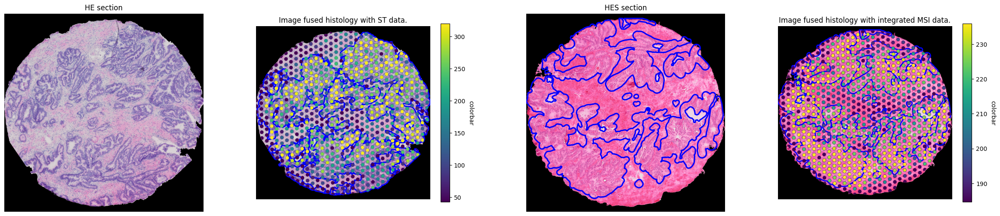

In [ ]:
# et_measurement_matrix_sep(measurement_df, ref_mat, st_table, col)
w_citsper_mat = get_measurement_matrix_sep(w_small_df, w_st_rmat, w_st_table, 'Citsper')
w_citrate_mat = get_measurement_matrix_sep(w_small_df, w_st_rmat, w_st_table, 'Citrate')

# st_hist = st_section.image.data.copy()
# st_hist = apply_mask(st_hist, st_section.segmentation_mask.data)

fig, axs = plt.subplots(1, 4, figsize=(30, 6))
for ax in axs:
    ax.axis('off')
axs[0].imshow(w_st_hist)
axs[0].set_title('HE section')

# axs1_st_hist = cv2.drawContours(st_hist, st_contours, -1, (0, 0, 255), 20)
# axs[1].imshow(axs1_st_hist)


w_axs1_st_hist = cv2.drawContours(w_st_hist.astype(np.uint8).copy(), w_st_contours, -1, (0, 0, 255), 20)
axs[1].imshow(w_axs1_st_hist)
# axs[1].imshow(w_st_hist)
w_st_rmat_b = w_st_rmat.copy().astype(bool)
w_citsper_mat[w_st_rmat_b] = w_citsper_mat[w_st_rmat_b] + 0.1
w_citsper_mat = apply_mask(w_citsper_mat, w_st_mask)
alpha_mat = w_citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citsper_mat[w_citsper_mat > 0], .15)
vmax = np.quantile(w_citsper_mat[w_citsper_mat > 0], .85)

ax_img = axs[1].imshow(w_citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[1].set_title('Image fused histology with ST data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[1], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")


w_msi_hist = pad_to_square(apply_mask(w_msi_section.image.data, w_msi_section.segmentation_mask.data))
w_axs3_msi_hist = cv2.drawContours(w_msi_hist.copy(), w_msi_contours, -1, (0, 0, 255), 20)
axs[2].imshow(w_axs3_msi_hist)
# axs[2].imshow(w_msi_hist)
axs[2].set_title('HES section')

# ax_img = axs[3].imshow(w_citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
w_axs3_msi_hist = cv2.drawContours(w_msi_hist.copy(), w_msi_contours, -1, (0, 0, 255), 20)
axs[3].imshow(w_axs3_msi_hist)
w_st_rmat_b = w_st_rmat.copy().astype(bool)
w_citrate_mat[w_st_rmat_b] = w_citrate_mat[w_st_rmat_b] + 0.1
w_citrate_mat = apply_mask(w_citrate_mat, pad_to_square(w_msi_section.segmentation_mask.data))
alpha_mat = w_citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citrate_mat[w_citrate_mat > 0], .15)
vmax = np.quantile(w_citrate_mat[w_citrate_mat > 0], .85)

ax_img = axs[3].imshow(w_citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
axs[3].set_title('Image fused histology with integrated MSI data.')

cbarlabel = 'colorbar'
cbar = ax.figure.colorbar(ax_img, ax=axs[3], shrink=.9)
cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")


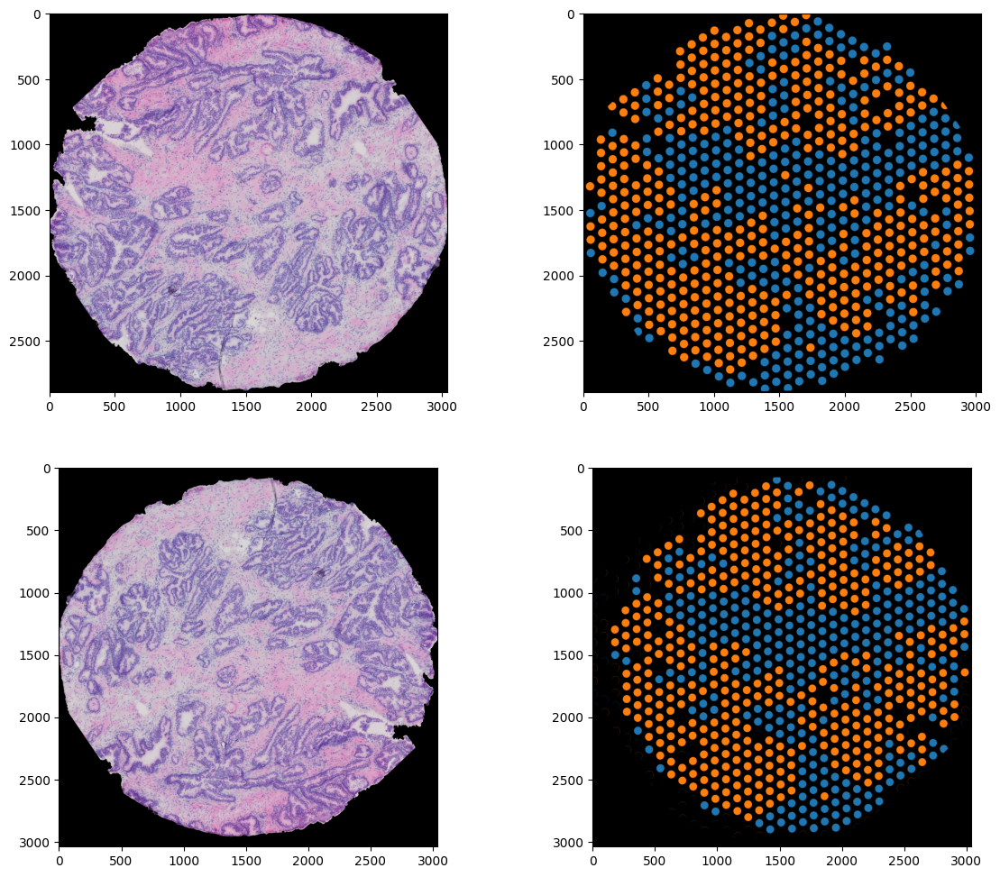

In [ ]:
correct_csgs_color_img = get_spot_coloring_img(small_df, st_ref_mat, st_table, 'msi_hist')
wrong_csgs_color_img = get_spot_coloring_img(w_small_df, w_st_rmat, w_st_table, 'msi_hist')

_, axs = plt.subplots(2, 2, figsize=(14, 12))
axs[0,0].imshow(st_hist)
axs[0,1].imshow(correct_csgs_color_img)
axs[1,0].imshow(w_st_hist)
axs[1,1].imshow(wrong_csgs_color_img)

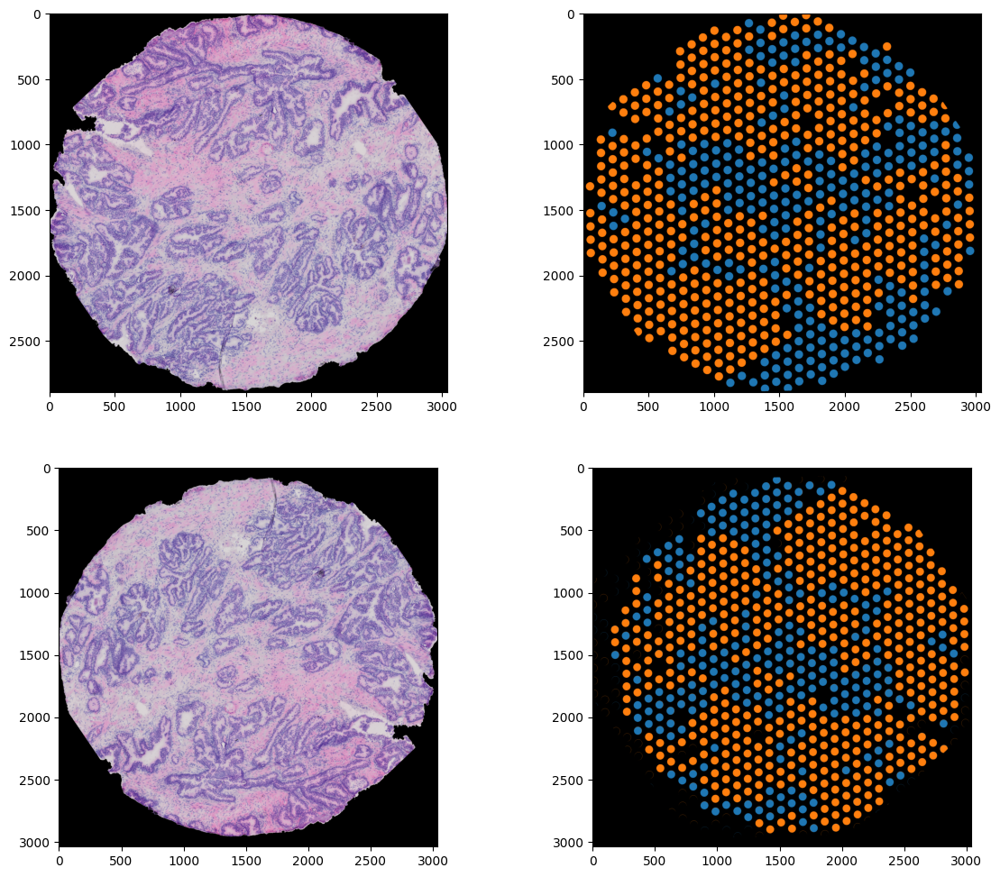

In [ ]:
correct_csgs_color_img = get_spot_coloring_img(small_df, st_ref_mat, st_table, 'unified_hp_class')
wrong_csgs_color_img = get_spot_coloring_img(w_small_df, w_st_rmat, w_st_table, 'unified_hp_class')

_, axs = plt.subplots(2, 2, figsize=(14, 12))
axs[0,0].imshow(st_hist)
axs[0,1].imshow(correct_csgs_color_img)
axs[1,0].imshow(w_st_hist)
axs[1,1].imshow(wrong_csgs_color_img)

In [ ]:
correct_csgs_color_img = get_spot_coloring_img(small_df, st_ref_mat, st_table)
wrong_csgs_color_img = get_spot_coloring_img(w_small_df, w_st_rmat, w_st_table)

# _, axs = plt.subplots(1, 2, figsize=(12, 6))
# axs[0].imshow(correct_csgs_color_img)
# axs[1].imshow(wrong_csgs_color_img)
_, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')
axs.imshow(correct_csgs_color_img)
plt.savefig('images/citsper_citrate_analysis/correct_spot_hp_class_exp1.png', transparent=True)
plt.close()

_, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')
axs.imshow(wrong_csgs_color_img)
plt.savefig('images/citsper_citrate_analysis/wrong_spot_hp_class_exp1.png', transparent=True)
plt.close()

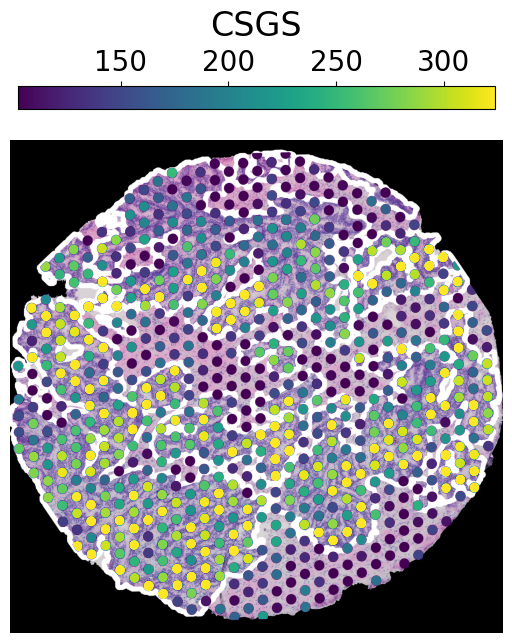

In [ ]:

fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')

# Correct data, st section
st_hist = st_image.copy()
st_hist = apply_mask(st_hist, st_segmentation_mask)
st_hist = pad_to_square(st_hist)
citsper_mat = pad_to_square(citsper_mat)
msi_hist = pad_to_square(msi_hist)
citrate_mat = pad_to_square(citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())

color = (255, 255, 255)

st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
st_gland_mat = pad_to_square(st_annotations.data[:,:,8])
st_contours, hierarchy = cv2.findContours(st_gland_mat, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
st_hist_w_gland_annotation = cv2.drawContours(st_hist, st_contours, -1, color, 30)
axs.imshow(st_hist_w_gland_annotation)
# axs.imshow(st_hist)
# axs[0].imshow(st_hist)
alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)

ax_img = axs.imshow(citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citsper_clim, max_citsper_clim))

cbarlabel = 'CSGS'

cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=24)
cbar.ax.tick_params(labelsize=20)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_1st_correct_st.png', transparent=True)

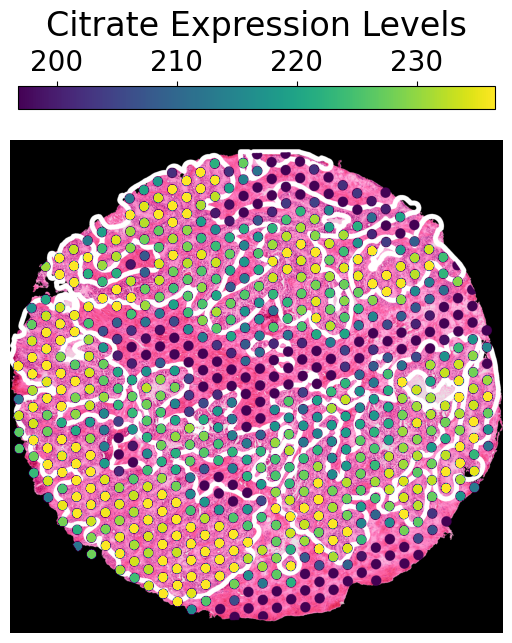

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))
axs.axis('off')

# Correct data, st section
st_hist = pad_to_square(st_hist)
citsper_mat = pad_to_square(citsper_mat)

msi_hist = apply_mask(msi_section.image.data, msi_section.segmentation_mask.data)
msi_hist = cv2.drawContours(msi_hist.copy(), msi_contours, -1, (255, 255, 255), 30)
msi_hist = pad_to_square(msi_hist)
citrate_mat = pad_to_square(citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())


# axs[0].imshow(st_hist)
alpha_mat = citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citsper_mat[citsper_mat > 0], .15)
vmax = np.quantile(citsper_mat[citsper_mat > 0], .85)

# axs[0].set_title('Correct: Histology fused with ST data.')

cbarlabel = 'Citsper Gene Scores'
# Correct data, msi section

msi_gland_annotation = pad_to_square(msi_section.annotations[0].data[:,:,2])
msi_contours, hierarchy = cv2.findContours(msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
msi_hist_w_gland_annotation = cv2.drawContours(msi_hist, msi_contours, -1, (255, 255, 255), 30)
axs.imshow(msi_hist_w_gland_annotation)
# axs.imshow(msi_hist)
alpha_mat = citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(citrate_mat[citrate_mat > 0], .15)
vmax = np.quantile(citrate_mat[citrate_mat > 0], .85)

ax_img = axs.imshow(citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citrate_clim, max_citrate_clim))
# axs[1].set_title('Correct: Histology fused with integrated MSI data.')

cbarlabel = 'Citrate Expression Levels'

cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=24)
cbar.ax.tick_params(labelsize=20)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_1st_correct_msi.png', transparent=True)


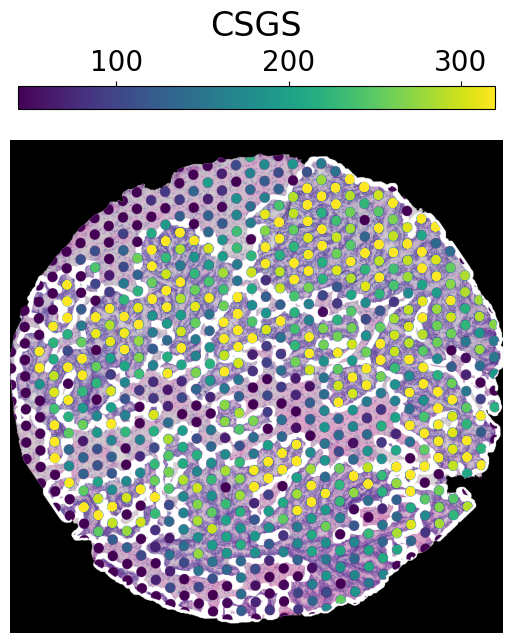

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))

axs.axis('off')

# Correct data, st section
st_hist = pad_to_square(st_hist)
citsper_mat = pad_to_square(citsper_mat)
msi_hist = pad_to_square(msi_hist)
citrate_mat = pad_to_square(citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())


# Wrong data, st section
w_st_annotations = load_st_annotation(join(integration_root_dir, core_name, '2', 'annotation_0'))
w_st_gland_mat = rotate_image(pad_to_square(w_st_annotations.data[:,:,8]))
w_st_contours, hierarchy = cv2.findContours(w_st_gland_mat.astype(np.uint8).copy(), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
w_st_hist_w_gland_annotation = cv2.drawContours(w_st_hist.astype(np.uint8).copy(), w_st_contours, -1, (255, 255, 255), 30)
axs.imshow(w_st_hist_w_gland_annotation)
# axs.imshow(w_st_hist)
alpha_mat = w_citsper_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citsper_mat[w_citsper_mat > 0], .15)
vmax = np.quantile(w_citsper_mat[w_citsper_mat > 0], .85)

ax_img = axs.imshow(w_citsper_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citsper_clim, max_citsper_clim))
cbarlabel = 'CSGS'


cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=24)
cbar.ax.tick_params(labelsize=20)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_1st_wrong_st.png', transparent=True)


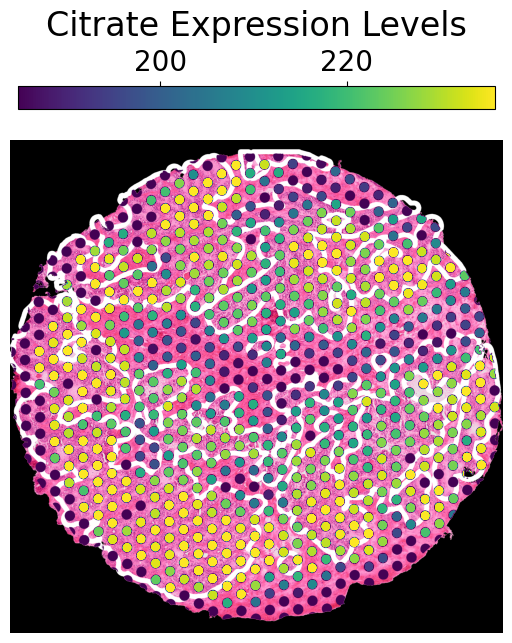

In [ ]:
fig, axs = plt.subplots(1, 1, figsize=(8, 8))

axs.axis('off')

# Correct data, st section
st_hist = pad_to_square(st_hist)
citsper_mat = pad_to_square(citsper_mat)
msi_hist = pad_to_square(msi_hist)
citrate_mat = pad_to_square(citrate_mat)

min_citrate_clim = min(citrate_mat[citrate_mat > 0].min(), w_citrate_mat[w_citrate_mat > 0].min())
max_citrate_clim = max(citrate_mat[citrate_mat > 0].max(), w_citrate_mat[w_citrate_mat > 0].max())

min_citsper_clim = min(citsper_mat[citsper_mat > 0].min(), w_citsper_mat[w_citsper_mat > 0].min())
max_citsper_clim = max(citsper_mat[citsper_mat > 0].max(), w_citsper_mat[w_citsper_mat > 0].max())


# Wrong data, msi section
w_msi_gland_annotation = pad_to_square(w_msi_section.annotations[0].data[:,:,2])
w_msi_contours, hierarchy = cv2.findContours(w_msi_gland_annotation, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
w_msi_hist_w_gland_annotation = cv2.drawContours(w_msi_hist, w_msi_contours, -1, (255, 255, 255), 30)
axs.imshow(w_msi_hist_w_gland_annotation)
# axs.imshow(msi_hist)
alpha_mat = w_citrate_mat.copy()
alpha_mat[alpha_mat != 0] = 1

vmin = np.quantile(w_citrate_mat[w_citrate_mat > 0], .15)
vmax = np.quantile(w_citrate_mat[w_citrate_mat > 0], .85)

ax_img = axs.imshow(w_citrate_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax, clim=(min_citrate_clim, max_citrate_clim))

cbarlabel = 'Citrate Expression Levels'
cbar = ax.figure.colorbar(ax_img, ax=axs, shrink=.77, location='top')
# cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom", size=22)
cbar.ax.set_xlabel(cbarlabel, rotation=0, va="bottom", size=24)
cbar.ax.tick_params(labelsize=20)

# cbar.ax.set_xlabel(cbarlabel, va="top", size=22)
plt.savefig('images/citsper_citrate_analysis/pof_1st_wrong_msi.png', transparent=True)


### Plot just stroma and gland spots

In [ ]:
import matplotlib as mpl

In [ ]:
# cmap = mpl.colormaps['viridis']
# stroma_color = cmap(1)
# gland_color = cmap(1)
gland_color = (30, 30, 230)
stroma_color = (230, 230, 30)
gland_color, stroma_color

In [ ]:
gland_spots = small_df[small_df.unified_hp_class == 'Non-cancer glands']
stroma_spots = small_df[small_df.unified_hp_class == 'Stroma']
msi_gland_spots = small_df[small_df.msi_hist == 'Non-cancer glands']
msi_stroma_spots = small_df[small_df.msi_hist == 'Stroma']
gland_spots.shape, stroma_spots.shape, msi_gland_spots.shape, msi_stroma_spots.shape

In [ ]:
gland_mat = get_measurement_matrix(gland_spots, st_data, 'Citsper')
gland_mat[gland_mat != 0] = 1
gland_mat = apply_mask(gland_mat, st_section.segmentation_mask.data)
gland_mat = pad_to_square(gland_mat)
stroma_mat = get_measurement_matrix(stroma_spots, st_data, 'Citsper')
stroma_mat[stroma_mat != 0] = 1
stroma_mat = apply_mask(stroma_mat, st_section.segmentation_mask.data)
stroma_mat = pad_to_square(stroma_mat)

msi_gland_mat = get_measurement_matrix(msi_gland_spots, st_data, 'Citsper')
msi_gland_mat[msi_gland_mat != 0] = 1
msi_gland_mat = pad_to_square(msi_gland_mat)
msi_stroma_mat = get_measurement_matrix(msi_stroma_spots, st_data, 'Citsper')
msi_stroma_mat[msi_stroma_mat != 0] = 1
msi_stroma_mat = pad_to_square(msi_stroma_mat)

In [ ]:
# Plot gland spots
_, axs = plt.subplots(1, 1, figsize=(8,8))
axs.axis('off')
gland_st_hist = st_hist.copy()
for i in range(gland_st_hist.shape[0]):
    for j in range(gland_st_hist.shape[1]):
        if gland_mat[i,j] == 1:
            gland_st_hist[i,j,:] = gland_color[:3]
axs.imshow(gland_st_hist)
plt.savefig('images/citsper_citrate_analysis/poc_1st_st_glands_highlighted.png')

In [ ]:
# Plot gland spots
_, axs = plt.subplots(1, 1, figsize=(8,8))
axs.axis('off')
stroma_st_hist = st_hist.copy()
for i in range(stroma_st_hist.shape[0]):
    for j in range(stroma_st_hist.shape[1]):
        if stroma_mat[i,j] == 1:
            stroma_st_hist[i,j,:] = stroma_color[:3]
axs.imshow(stroma_st_hist)
plt.savefig('images/citsper_citrate_analysis/poc_1st_st_stroma_highlighted.png')

In [ ]:
# Plot gland spots
_, axs = plt.subplots(1, 1, figsize=(8,8))
axs.axis('off')
all_spots_st_hist = st_hist.copy()
for i in range(all_spots_st_hist.shape[0]):
    for j in range(all_spots_st_hist.shape[1]):
        if stroma_mat[i,j] == 1:
            all_spots_st_hist[i,j,:] = stroma_color[:3]
        elif gland_mat[i,j] == 1:
            all_spots_st_hist[i,j,:] = gland_color[:3]
        
axs.imshow(all_spots_st_hist)
# plt.savefig('images/citsper_citrate_analysis/poc_1st_st_all_spots_highlighted.png')

NameError: name 'plt' is not defined

In [ ]:
# Plot gland spots
_, axs = plt.subplots(1, 1, figsize=(8,8))
axs.axis('off')
gland_msi_hist = msi_hist.copy()
for i in range(gland_msi_hist.shape[0]):
    for j in range(gland_msi_hist.shape[1]):
        if msi_gland_mat[i,j] == 1:
            gland_msi_hist[i,j,:] = gland_color[:3]
axs.imshow(gland_msi_hist)
plt.savefig('images/citsper_citrate_analysis/poc_1st_msi_glands_highlighted.png')

In [ ]:
# Plot gland spots
_, axs = plt.subplots(1, 1, figsize=(8,8))
axs.axis('off')
stroma_msi_hist = msi_hist.copy()
for i in range(stroma_msi_hist.shape[0]):
    for j in range(stroma_msi_hist.shape[1]):
        if msi_stroma_mat[i,j] == 1:
            stroma_msi_hist[i,j,:] = stroma_color[:3]
axs.imshow(stroma_msi_hist)
plt.savefig('images/citsper_citrate_analysis/poc_1st_msi_stroma_highlighted.png')

In [ ]:
# Plot gland spots
_, axs = plt.subplots(1, 1, figsize=(8,8))
axs.axis('off')
all_spots_msi_hist = msi_hist.copy()
for i in range(all_spots_msi_hist.shape[0]):
    for j in range(all_spots_msi_hist.shape[1]):
        if msi_stroma_mat[i,j] == 1:
            all_spots_msi_hist[i,j,:] = stroma_color[:3]
        elif msi_gland_mat[i,j] == 1:
            all_spots_msi_hist[i,j,:] = gland_color[:3]
axs.imshow(all_spots_msi_hist)
plt.savefig('images/citsper_citrate_analysis/poc_1st_msi_all_spots_highlighted.png')

In [ ]:
import json
from miit.spatial_data.image import NamedAnnotation, Annotation


label_path = '../configs/integration/annotations/new_labels.txt'
msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'
# core_name = '004_02'
# core_name = '002_01'
core_name = '002_04'

config_path = f'../configs/cores_hr/{core_name}.json'
st_identifier = get_st_identifier(core_name, metadata_df)
integration_root_dir = '../save_directories/multisection_integration/direct/integrated_dataset_citrate_project_1/'
st_section_path = join(integration_root_dir, core_name, '2')
st_section = Section.from_directory(st_section_path)
st_data = st_section.molecular_data
# msi_section_integrated_path = join(integration_root_dir, core_name, '7')
# msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
msi_section = RegGraph.from_config_path(config_path, filter_ids=[7]).sections[7]
sections = {
    7: msi_section
}
with open(config_path) as f:
    config = json.load(f)
    msi_name = [x for x in config['sections'] if x['id'] == 7][0]['name']
    msi_hist_path = join(msi_histopathology_path, msi_name + '.nii.gz')
    msi_annotations = sitk.GetArrayFromImage(sitk.ReadImage(msi_hist_path))
    # print(msi_annotations.shape)
    msi_annotations = np.moveaxis(msi_annotations, 0, 2)
    with open(label_path) as f:
        labels = [x.strip() for x in f.readlines()]
    msi_named_ann = NamedAnnotation(msi_annotations, labels)
    msi_section.annotations = [msi_named_ann]

In [ ]:
import cv2
def get_max_contour(contours):
    max_contour = None
    max_len = -1
    max_idx = 0
    for idx, contour in enumerate(contours):
        if contour.shape[0] > max_len:
            max_len = contour.shape[0]
            max_contour = contour
            max_idx = idx
    return max_contour, max_idx
# mask = msi_section.annotations[0].data[:,:,1]
contours, hierarchy = cv2.findContours(image=mask, mode=cv2.RETR_TREE, method=cv2.CHAIN_APPROX_SIMPLE)
contour, max_idx = get_max_contour(contours)
max_idx

In [ ]:
st_section_unregistered = RegGraph.from_config_path(config_path, filter_ids=[2]).sections[2]

# Show amount of stroma and glands

In [ ]:
def get_ion_image(mapped_measurements, 
                                msi_data,
                                quantile_norm=True,
                                mask=None):
    ref_mat = msi_data.ref_mat.data.astype(int)
    if mask is not None:
        ref_mat = apply_mask(ref_mat, mask)
    indexer = np.array([mapped_measurements.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    if quantile_norm:
        vmin = np.quantile(measurement_mat[measurement_mat > 0], .1)
        vmax = np.quantile(measurement_mat[measurement_mat > 0], .9)
        measurement_mat[measurement_mat < vmin] = vmin
        measurement_mat[measurement_mat > vmax] = vmax
    return measurement_mat

def convert_heatmap_to_image(heatmap):
    values = np.unique(heatmap)
    values = np.array([x for x in values if x != 0])
    max_value = np.max(values)
    if max_value <= 1:
        max_value = 1
    cmap = mpl.colormaps['viridis']
    # indexer = np.array([x for x in np.unique(heatmap)])
    # indexer = np.array([cmap(.get(i, 0) for i in range(heatmap.min(), heatmap.max() + 1)])
    # measurement_mat = indexer[(ref_mat - ref_mat.min())]
    color_mat = np.zeros((heatmap.shape[0], heatmap.shape[1], 3))
    for i in range(color_mat.shape[0]):
        for j in range(color_mat.shape[1]):
            val = heatmap[i,j] / max_value
            if val != 0:
                # cpx = cmat[val]
                color_mat[i, j, :] = np.array(cmap(val)[:-1])
    return color_mat

In [ ]:
intensities = extract_ion_image(msi_section)
citrate_intensities = to_single_intensity_dict(intensities, 0)
ion_image = map_intensities_on_image(msi_section, citrate_intensities)


In [ ]:
_, axs = plt.subplots(2, 5, figsize=(30, 12))
for i in range(axs.shape[0]):
    for j in range(axs.shape[1]):
        axs[i,j].axis('off')
axs[0, 0].imshow(ion_image)
axs[0, 0].set_title('Ion Image - Citrate')
vmin = np.quantile(ion_image[ion_image > 0], .2)
vmax = np.quantile(ion_image[ion_image > 0], .8)
axs[0, 1].imshow(ion_image, vmin=vmin, vmax=vmax)
axs[0, 1].set_title('Ion Image - Citrate - Quantile Scaled')
hist_img = st_section.image.data
hist_img = np.zeros_like(hist_img)
plot_spots_with_measurement(small_df, st_data, 'met_Citrate', hist_img=hist_img, ax=axs[0, 2])
axs[0,2].set_title('Citrate Measurements Integrated.')
# plot_spots_with_measurement(small_df, st_data, 'tissue_num_msi', hist_img=hist_img, ax=axs[0, 3])
# axs[0,3].set_title('Gland from MSI annotation score.')
plot_spots_with_measurement(small_df, st_data, 'Citsper', hist_img=hist_img, ax=axs[0, 3])
axs[0,3].set_title('Citsper scores.')
# plot_spots_with_measurement(gl_small_df, st_data, 'tissue_num_st', hist_img=hist_img, ax=axs[0, 4])
# axs[0,4].set_title('Gland from Spot annotations.')

axs[1, 0].imshow(st_section.image.data)
axs[1, 0].set_title('Histology - ST section')
axs[1, 1].imshow(msi_section.image.data)
axs[1, 1].set_title('Histology - MSI section')
axs[1, 2].imshow(msi_section.annotations[0].data)
axs[1, 2].set_title('Histology - Gland annotations')
# plot_spots_with_measurement(gl_small_df, st_data, 'normal_gland_msi', hist_img=hist_img, ax=axs[1, 3], quantile_norm=False)
# axs[1, 3].set_title('Gland spots msi.')

# plot_spots_with_measurement(gl_small_df, st_data, 'matching_spots', hist_img=hist_img, ax=axs[1, 4])
# axs[1, 4].set_title(f'Gland spots matching.')
# plot_spots_with_measurement(gl_small_df, st_data, 'normal_gland_msi_temp', hist_img=hist_img, ax=axs[1, 4], quantile_norm=False)
# axs[1, 4].set_title(f'Gland spots with threshold: {threshold}.')


### Try plotting with images and spots

In [ ]:
def merge_dicts(dict1, dict2):
    new_dict = {}
    for key in dict1:
        if dict1[key] in dict2:
            new_dict[key] = dict2[dict1[key]]
    return new_dict

def get_measurement_dict(df, col1, col2):
    dct = {}
    for _, row in df.iterrows():
        dct[row[col1]] = row[col2]
    return dct

def pd_col_to_dict(table, col):
    dct = {}
    for idx, row in table.iterrows():
        dct[idx] = row[col]
    return dct

def plot_gene_counts(st_data, col, hist_img=None, ax=None, quantile_norm=True):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    if hist_img is None:
        hist_img = st_data.image.data
        


def plot_spots_with_measurement(measurement_df, 
                                st_data, col, 
                                hist_img=None, 
                                ax=None, 
                                quantile_norm=True,
                                mask=None):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    ref_mat = st_data.index_mask.data.astype(int)
    if mask is not None:
        ref_mat = apply_mask(ref_mat, mask)
    local_idx_measurement_dict = pd_col_to_dict(measurement_df, col)

    intern_idx_local_idx_dict = {}
    for idx, row in st_data.table.data.iterrows():
        intern_idx_local_idx_dict[int(row['int_idx'])] = idx
    merged_dict = merge_dicts(intern_idx_local_idx_dict, local_idx_measurement_dict)
    indexer = np.array([merged_dict.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    if hist_img is not None:
        ax.imshow(hist_img)    
    alpha_mat = measurement_mat.copy()
    alpha_mat[alpha_mat != 0] = 1
    if quantile_norm:
        vmin = np.quantile(measurement_mat[measurement_mat > 0], .1)
        vmax = np.quantile(measurement_mat[measurement_mat > 0], .9)
        ax.imshow(measurement_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
    else:
        ax.imshow(measurement_mat, alpha=alpha_mat)    
    return ax

def plot_wrong_spots_with_measurement(measurement_df, 
                                      ref_mat,
                                      st_data, col, 
                                      hist_img=None, 
                                      ax=None, 
                                      quantile_norm=True,
                                      mask=None):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    # ref_mat = st_data.index_mask.data.astype(int)
    if mask is not None:
        ref_mat = apply_mask(ref_mat, mask).astype(int)
    local_idx_measurement_dict = pd_col_to_dict(measurement_df, col)

    intern_idx_local_idx_dict = {}
    for idx, row in st_data.table.data.iterrows():
        intern_idx_local_idx_dict[int(row['int_idx'])] = idx
    merged_dict = merge_dicts(intern_idx_local_idx_dict, local_idx_measurement_dict)
    indexer = np.array([merged_dict.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    if hist_img is not None:
        ax.imshow(hist_img)    
    alpha_mat = measurement_mat.copy()
    alpha_mat[alpha_mat != 0] = 1
    if quantile_norm:
        vmin = np.quantile(measurement_mat[measurement_mat > 0], .1)
        vmax = np.quantile(measurement_mat[measurement_mat > 0], .9)
        ax.imshow(measurement_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
    else:
        ax.imshow(measurement_mat, alpha=alpha_mat)    
    return ax


def get_peaks(msi, rel_percentage=0.00025):
    mzs = msi.getspectrum(0)[0]
    mean_intensities = compute_mean_spectrum(msi)
    norm_intensities = mean_intensities / trapezoid(y=mean_intensities, x=None)
    norm_intensities = 100 * norm_intensities /  norm_intensities.max()
    # norm_intensities = 100 * norm_intensities /  mean_intensities.max()
    peaks, _ = find_peaks(norm_intensities, height=rel_percentage)
    # print(mzs.shape, mzs)
    p_m = [(mean_intensities, mzs)]
    return p_m
    # return [(peaks, mzs[peaks])]


def find_ided_peaks2(peaks, peak_table, mass_error_mz=0.03):
    _ret = []
    for _idxs, _mzs in peaks:
        _t_idx = []
        _t_mz = []
        _t_id = []
        for _idx, _mz in zip(_idxs, _mzs):
            if (np.abs(peak_table['m/z'] - _mz)).min() <= mass_error_mz:
                _t_idx.append(_idx)
                _t_mz.append(_mz)
                _t_id.append(peak_table['ID'].iloc[(np.abs(peak_table['m/z'] - _mz)).argmin()])
        _ret.append((_t_idx, _t_mz, _t_id))
    return _ret

def find_ided_peaks(peaks, peak_table, mass_error_mz=2.00000):
    peak_max_diffs = np.abs(peak_table['m/z'] - peak_table['m/z'] * (1 + mass_error_mz))
    _ret = []
    for _idxs, _mzs in peaks:
        _t_idx = []
        _t_mz = []
        _t_id = []
        for _idx, _mz in zip(_idxs, _mzs):
            peak_table_val = peak_table['m/z']
            diffs = np.abs(peak_table_val - _mz)
            sub_table = peak_table[diffs < peak_max_diffs]
            if sub_table.shape[0] > 0:
                _t_idx.append(_idx)
                _t_mz.append(_mz)
                _t_id.append(peak_table['ID'].iloc[(np.abs(peak_table['m/z'] - _mz)).argmin()])
        _ret.append((_t_idx, _t_mz, _t_id))
    return _ret

def get_one_peak_dict_and_interval_list(peaks_id, delta_factor=2, default_interval_delta=0.00025):
    _ret = {}
    _ret_ints = []
    for _idxs, _mzs, _ids in peaks_id:
        for _idx, _mz, _id in zip(_idxs, _mzs, _ids):
            if not _id in _ret:
                _ret[_id] = {}
                _ret[_id]['mzs'] = []
                _ret[_id]['interval'] = None
            _ret[_id]['mzs'].append(_mz)
    for _id, _data in _ret.items():
        _d = np.max(_ret[_id]['mzs']) - np.min(_ret[_id]['mzs'])
        if _d > 0:
            _int_delta = delta_factor * _d / np.mean(_ret[_id]['mzs'])
        else:
            _int_delta = default_interval_delta
        _ret[_id]['interval'] = (np.mean(_ret[_id]['mzs']), _int_delta)
        _ret_ints.append(_ret[_id]['interval'])
    return _ret, _ret_ints
  

def load_metabolites(imzml_path):
    NEDC_peak_table = pd.read_csv('Peaklist_136_NEDC_figshare.txt', sep='\t')
    NEDC_peak_table_IDed = NEDC_peak_table[NEDC_peak_table['ID'].notna()][['m/z', 'ID', 'ID in OPLSDA']].reset_index(drop=True)
    msi = ImzMLParser(imzml_path)
    peaks = get_peaks(msi, rel_percentage=0.00005)
    peak_dict, peak_intervals = get_one_peak_dict_and_interval_list(find_ided_peaks(peaks, NEDC_peak_table_IDed))
    return peak_dict, NEDC_peak_table_IDed

def load_arguments(imzml_path):
    metabolites = []
    # citrate = {'name': 'Citrate', 'start': 189.9423, 'end': 190.137}
    # metabolites.append((189.9423, 190.137, 'Citrate'))
    peak_dict, theoretical_peak_locations = load_metabolites(imzml_path)
    theoretical_peak_dct = theoretical_id_2_mz(theoretical_peak_locations)

    for key in peak_dict:
        theoretical_peak_location = theoretical_peak_dct[key]
        peak_dict[key]['theoretical_value'] = theoretical_peak_location
        peak_dict[key]['difference_peaks'] = np.abs(theoretical_peak_location - peak_dict[key]['mzs'][0])    
    args = {}
    args[7] = {'mz_intervals': to_new_format_mz()}
    # args[7] = {'mz_intervals': peak_dict}
    args[2] = {'annotation_path': 'configs/integration/annotations/labels.txt'}
    return args

def compute_mean_spectrum(msi):
    total_intensities = None
    for i in range(len(msi.coordinates)):
        mzs, intensities = msi.getspectrum(i)
        if total_intensities is None:
            total_intensities = intensities.copy()
        else:
            total_intensities += intensities
    avg_spec = total_intensities/len(msi.coordinates)
    return avg_spec

def theoretical_id_2_mz(df):
    dct = {}
    for _, row in df.iterrows():
        id_ = row['ID']
        mz = row['m/z']
        dct[id_] = mz
    return dct

def to_new_format_mz():
    df = pd.read_csv('IdentifiedPeaks.csv', sep=';')
    return df['Name'].to_list()

def plot_ion_image(mapped_measurements, 
                                msi_data,
                                hist_img=None, 
                                ax=None, 
                                quantile_norm=True,
                                mask=None):
    if ax is None:
        _, ax = plt.subplots(1, 1, figsize=(6,6))
    # if hist_img is None:
    #     hist_img = st_data.image.data
    # spot_ids_ = get_matching_indices(spot_ids, st_data.table.data.index.to_list())
    # spot_ids = measurement_df.local_index.to_list()
    # intern_idxs = set(st_data.table.data.loc[spot_ids]['int_idx'].to_list())
    ref_mat = msi_data.ref_mat.data.astype(int)
    if mask is not None:
        ref_mat = apply_mask(ref_mat, mask)
    # local_idx_measurement_dict = pd_col_to_dict(measurement_df, col)
    # local_idx_measurement_dict = get_measurement_dict(measurement_df, 'local_index', col)
    # st_table = st_data.table.data.loc[measurement_df.local_index.to_list()]
    # intern_idx_local_idx_dict = {}
    # for idx, row in st_data.table.data.iterrows():
    # # for idx, row in st_table.iterrows():
    #     intern_idx_local_idx_dict[int(row['int_idx'])] = idx
    # merged_dict = merge_dicts(intern_idx_local_idx_dict, local_idx_measurement_dict)
    indexer = np.array([mapped_measurements.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    # match_mat = get_measurement_mat(ref_mat, measurement_dict)
    if hist_img is not None:
        ax.imshow(hist_img)    
    alpha_mat = measurement_mat.copy()
    alpha_mat[alpha_mat != 0] = 1
    if quantile_norm:
        vmin = np.quantile(measurement_mat[measurement_mat > 0], .1)
        vmax = np.quantile(measurement_mat[measurement_mat > 0], .9)
        ax.imshow(measurement_mat, alpha=alpha_mat, vmin=vmin, vmax=vmax)
    else:
        ax.imshow(measurement_mat, alpha=alpha_mat)    
    return ax

def mapped_measurement_dict_to_mat(mapped_measurements, ref_mat):
    indexer = np.array([mapped_measurements.get(i, 0) for i in range(ref_mat.min(), ref_mat.max() + 1)])
    measurement_mat = indexer[(ref_mat - ref_mat.min())]
    return measurement_mat

In [ ]:
import cv2

In [ ]:
core_name = '002_01'
config_path = f'../configs/cores_hr/{core_name}.json'
graph = RegGraph.from_config_path(config_path, filter_ids=[7])
msi_section = graph.sections[7]

warped_data_root_dir = '../../GreedyFHist/save_directories/multisection_integration/direct/multiomics_registration_exhaustive'
target_dir = '/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180'
label_path = 'configs/integration/annotations/new_labels.txt'
msi_histopathology_path = '/mnt/scratch/maximilw/data/multiomics/hes_scans/high_res/additional_annotations/histology/'
path_to_warped_section = join(warped_data_root_dir, core_name, 'warped_section/')


st_section = Section.from_directory(path_to_warped_section)
wrong_image_path = f'/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180/{core_name}/rotated_data/target_img.png'
wrong_rmat_path = f'/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180/{core_name}/rotated_data/target_rmat_new.nii.gz'
wrong_seg_mask_path = f'/mnt/scratch/maximilw/multiomics_integration/integrated_dataset_sebastian__root_mean_square_wrong_rotation_for_analysis_180/{core_name}/rotated_data/target_seg_mask_new.nii.gz'
wrong_img = cv2.imread(wrong_image_path)
wrong_rmat = sitk.GetArrayFromImage(sitk.ReadImage(wrong_rmat_path)).astype(int)
wrong_seg_mask = sitk.GetArrayFromImage(sitk.ReadImage(wrong_seg_mask_path))

                                    

In [ ]:
_, axs = plt.subplots(1, 3, figsize=(18,6))
for ax in axs:
    ax.axis('off')
axs[0].imshow(st_section.image.data)
axs[0].set_title('ST image')
axs[1].imshow(msi_section.image.data)
axs[1].set_title('MSI image')
axs[2].imshow(wrong_img)
axs[2].set_title('Wrongly rotated')

In [ ]:
# def plot_wrong_spots(rmat, 

# w_spot_annotations_df_merged_matching.Citsper

In [ ]:
# w_spot_annotations_df_merged_matching.set_index('barcode')

In [ ]:
# nag_df = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.msi_hist == 'Non-cancer glands']
# nag_df

In [ ]:
_, axs =plt.subplots(1, 4, figsize=(24,6))
for ax in axs:
    ax.axis('off')
    
st_data = st_section.molecular_data
col = 'Citsper'
nag_df = w_spot_annotations_df_merged_matching[w_spot_annotations_df_merged_matching.msi_hist == 'Non-cancer glands']
nag_df = nag_df[nag_df.core_name == core_name]
plot_wrong_spots_with_measurement(nag_df.set_index('barcode'), 
                                      wrong_rmat,
                                      st_data, 
                                      col, 
                                      hist_img=wrong_img,
                                      ax=axs[0], 
                                      quantile_norm=False,
                                      mask=wrong_seg_mask)

col = 'met_median_Citrate'
plot_wrong_spots_with_measurement(nag_df.set_index('barcode'), 
                                      wrong_rmat,
                                      st_data, 
                                      col, 
                                      hist_img=wrong_img,
                                      ax=axs[1], 
                                      quantile_norm=False,
                                      mask=wrong_seg_mask)

col = 'met_Citrate'
nag_df = spot_annotations_df_merged_matching[spot_annotations_df_merged_matching.msi_hist == 'Non-cancer glands']
nag_df = nag_df[nag_df.core_name == core_name]
plot_spots_with_measurement(nag_df.set_index('barcode'),
                            st_data,
                            col,
                            hist_img=st_section.image.data,
                            ax=axs[2],
                            quantile_norm=False,
                            mask=st_section.segmentation_mask.data)

col = 'Citsper'
plot_spots_with_measurement(nag_df.set_index('barcode'),
                            st_data,
                            col,
                            hist_img=st_section.image.data,
                            ax=axs[3],
                            quantile_norm=False,
                            mask=st_section.segmentation_mask.data)